<a href="https://colab.research.google.com/github/mahidul5130/Fresh-or-Stale-Leveraging-Deep-Learning-to-Detect-Freshness-of-Fruits-and-Vegetables/blob/main/Thesis_Defence_ResearchLabPc.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# root_location = '/home/19101548@bracu.ac.bd/Desktop/THESIS/'

root_location = "/content/drive/MyDrive/THESIS/"

# **<font color="Red">Data Preprocessing**

In [ ]:
# train_path = root_location+'/FinDatasetBalanced/train'
# valid_path = root_location+'/FinDatasetBalanced/val'
# test_path = root_location+'/FinDatasetBalanced/test'

train_path = root_location+'/Data/FinDatasetBalanced/train'
valid_path = root_location+'/Data/FinDatasetBalanced/val'
test_path = root_location+'/Data/FinDatasetBalanced/test'

In [ ]:
import os
from keras.preprocessing.image import ImageDataGenerator
import tensorflow as tf

classe_labels = os.listdir(train_path)
classe_labels = ['fresh_lime', 'fresh_apple', 'stale_pomegranate', 'fresh_capsicum', 'stale_tomato', 'fresh_guava', 'stale_apple', 'stale_lime', 'stale_banana', 'fresh_pomegranate', 'stale_guava', 'fresh_orange', 'stale_capsicum','stale_orange', 'fresh_tomato', 'fresh_banana']

train_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.vgg19.preprocess_input) \
    .flow_from_directory(directory=train_path, target_size=(224,224), classes=classe_labels, batch_size=32)
valid_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.vgg19.preprocess_input) \
    .flow_from_directory(directory=valid_path, target_size=(224,224), classes=classe_labels, batch_size=32)
test_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.vgg19.preprocess_input) \
    .flow_from_directory(directory=test_path, target_size=(224,224), classes=classe_labels, batch_size=32, shuffle=False)

Found 25760 images belonging to 16 classes.
Found 7360 images belonging to 16 classes.
Found 3680 images belonging to 16 classes.


In [ ]:
from sklearn.utils.multiclass import class_distribution
print(classe_labels)
print(len(classe_labels))

result = [] 
[result.append(x) for x in classe_labels if x not in result] 

# printing list after removal 
print (str(result))
print(len(result))

['fresh_lime', 'fresh_apple', 'stale_pomegranate', 'fresh_capsicum', 'stale_tomato', 'fresh_guava', 'stale_apple', 'stale_lime', 'stale_banana', 'fresh_pomegranate', 'stale_guava', 'fresh_orange', 'stale_capsicum', 'stale_orange', 'fresh_tomato', 'fresh_banana']
16
['fresh_lime', 'fresh_apple', 'stale_pomegranate', 'fresh_capsicum', 'stale_tomato', 'fresh_guava', 'stale_apple', 'stale_lime', 'stale_banana', 'fresh_pomegranate', 'stale_guava', 'fresh_orange', 'stale_capsicum', 'stale_orange', 'fresh_tomato', 'fresh_banana']
16


# **<font color="Red">Visualize Classes**

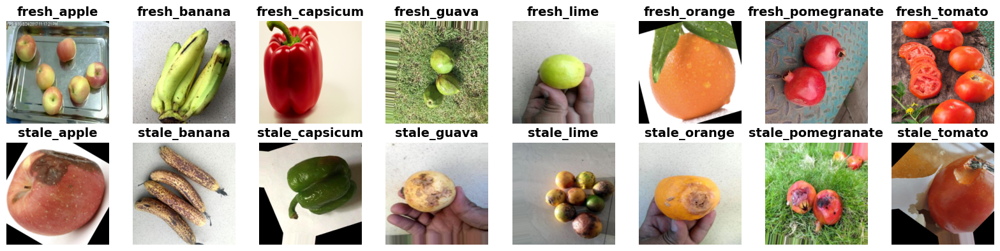

In [ ]:
import os
import random
import matplotlib.pyplot as plt
from PIL import Image

# Root location
# root_location = "/path/to/root/location"

# Path to the parent folder containing the 16 folders
parent_folder = os.path.join(root_location, "Data/FinDatasetBalanced/train")

# Get a list of all the subfolders in the parent folder
subfolders = [f.path for f in os.scandir(parent_folder) if f.is_dir()]

# Sort subfolders alphabetically
subfolders.sort()

# Create a figure with 2 rows and 8 columns
fig, axs = plt.subplots(2, 8, figsize=(16, 4))

# Flatten the axes array for easy indexing
axs = axs.flatten()

# Loop through each subfolder
for i, folder in enumerate(subfolders):
    # Get the folder name
    folder_name = os.path.basename(folder)
    
    # Get a list of all the image files in the subfolder
    image_files = [f.path for f in os.scandir(folder) if f.is_file() and f.name.endswith((".jpg", ".jpeg", ".png"))]
    
    # Check if there are any image files in the subfolder
    if len(image_files) > 0:
        # Randomly select one image file
        selected_image = random.choice(image_files)
        
        # Open and resize the selected image
        image = Image.open(selected_image).resize((224, 224))
        
        # Plot the image in the corresponding subplot
        axs[i].imshow(image)
        axs[i].axis('off')
        
        # Set the label as the folder name
        axs[i].set_title(folder_name, fontsize=14, fontweight='bold')

# Adjust spacing between subplots
plt.tight_layout()

# Save the figure as a PDF file
plt.savefig('figure.pdf', bbox_inches='tight')

# Show the figure
plt.show()


# **<font color="red">AccuracyPerEpoch**

In [ ]:
import matplotlib.pyplot as plt 
def accuracyLoss(model_history, name):

  dir = root_location+"/Thesis Save Data/"+name+"/"

  # summarize history for accuracy
  plt.plot(model_history['accuracy'])
  plt.plot(model_history['val_accuracy'])
  plt.title('model accuracy '+ name)
  plt.ylabel('accuracy')
  plt.xlabel('epoch')
  plt.legend(['train', 'test'], loc='upper left')
  plt.savefig(dir+name+'_AccuracyPerEpoch.png')
  plt.show()


  # summarize history for loss
  plt.plot(model_history['loss'])
  plt.plot(model_history['val_loss'])
  plt.title('model loss '+ name)
  plt.ylabel('loss')
  plt.xlabel('epoch')
  plt.legend(['train', 'test'], loc='upper left')
  plt.savefig(dir+name+'_LossPerEpoch.png')
  plt.show()

# **<font color="red">Save and Load a Model and Its history**

In [ ]:
def SaveHistory(model, name):
  import os
  import os.path
  directory = root_location+"/Code/Thesis Save Data/"+name+"/"
  from pathlib import Path
  Path(directory).mkdir(parents=True, exist_ok=True)
  np.save(directory+name+".npy",model.history)

In [ ]:
def LoadHistory(name):
  directory = root_location+"/Code/Thesis Save Data/"+name+"/"+name+".npy"
  model = np.load(directory,allow_pickle='TRUE').item()
  return model

In [ ]:
def SavingEntirety(model, name):
  import os
  import os.path
  directory = root_location+"/Code/Thesis Save Data/"+name+"/"
  from pathlib import Path
  Path(directory).mkdir(parents=True, exist_ok=True)
  model.save(directory+name+".h5")

In [ ]:
def LoadingEntirety(name):
  directory = root_location+"/Code/Thesis Save Data/"+name+"/"
  from tensorflow import keras
  model = keras.models.load_model(directory+name+'.h5')
  return model

# **<font color="red">Confusion Tree**

In [ ]:
from sklearn.metrics import confusion_matrix

def ConfusionMatrix(model, name):
    import itertools
    test_labels = test_batches.classes
    predictions = model.predict(x=test_batches, steps=len(test_batches), verbose=1)
    cm = confusion_matrix(y_true=test_labels, y_pred=predictions.argmax(axis=1))

    def plot_confusion_matrix(cm, classes,
                              normalize=False,
                              title='Confusion matrix',
                              cmap=plt.cm.Blues):
        plt.figure(figsize=(25,25)) 


        """
        This function prints and plots the confusion matrix.
        Normalization can be applied by setting `normalize=True`.
        """
        plt.imshow(cm, interpolation='nearest', cmap=cmap)
        plt.title(title)
        plt.colorbar()
        tick_marks = np.arange(len(classes))
        plt.xticks(tick_marks, classes, rotation=45)
        plt.yticks(tick_marks, classes)

        if normalize:
            cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
            print("Normalized confusion matrix")
        else:
            print('Confusion matrix, without normalization')

        print(cm)

        thresh = cm.max() / 2.
        for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
            plt.text(j, i, cm[i, j],
                horizontalalignment="center",
                color="white" if cm[i, j] > thresh else "black")

        plt.tight_layout()
        plt.ylabel('True label')
        plt.xlabel('Predicted label')
        dir = root_location+"/Thesis Save Data/"+name+"/"
        plt.savefig(dir+name+'_Confusion Matrix.png')

    test_batches.class_indices
    cm_plot_labels = classe_labels
    plot_confusion_matrix(cm=cm, classes=cm_plot_labels, title=name+'Confusion Matrix')

# **<font color="red">Testing Accuracy**

In [ ]:
from sklearn.metrics import accuracy_score

def TestingAccuracy(model, name):
    import itertools
    test_labels = test_batches.classes
    predictions = model.predict(x=test_batches, steps=len(test_batches), verbose=1)
    AccuracyScores = accuracy_score(y_true=test_labels, y_pred=predictions.argmax(axis=1))

    import pandas as pd
    directory = root_location+"/Code/Thesis Save Data/"+name+"/"
    TEST_AUC_csv = [[name, AccuracyScores]]
    TEST_AUC_csv = pd.DataFrame(TEST_AUC_csv, columns=['Model Name', 'TEST-auc Score'])
    directory_TEST_AUC = directory+name+" TEST Score.csv"
    TEST_AUC_csv.to_csv(directory_TEST_AUC,index=False)

    return AccuracyScores

# **<font color="red">ROC AUC And Classification Report**

In [ ]:
from sklearn.metrics import roc_auc_score, classification_report
def ROC_AUC_Classification_Report(loaded_model, name):
  import pandas as pd
  directory = root_location+"/Thesis Save Data/"+name+"/"
  predictions = loaded_model.predict(x=test_batches, steps=len(test_batches), verbose=1)
  y_true = test_batches.classes
  
  ROC_AUC = roc_auc_score(y_true, predictions, multi_class='ovr')
  ROC_AUC_csv = [[name, ROC_AUC]]
  ROC_AUC_csv = pd.DataFrame(ROC_AUC_csv, columns=['Model Name', 'ROC-auc Score'])
  
  cr_normal = classification_report(y_true, predictions.argmax(axis=1), target_names=classe_labels)

  cr = classification_report(y_true, predictions.argmax(axis=1), target_names=classe_labels, output_dict=True)
  cr_csv = pd.DataFrame(cr).transpose()

  directory_ROC_AUC = directory+name+" ROC AUC Score.csv"
  ROC_AUC_csv.to_csv(directory_ROC_AUC,index=False)

  
  directory_Classification_Report = directory+name+" Classification Report.csv"
  cr_csv.to_csv(directory_Classification_Report, index=False)
  
  return ROC_AUC, cr_normal

In [ ]:
import time

In [ ]:
def plot_roc_curve(model, model_name):
    import pandas as pd
    from sklearn.metrics import roc_curve, auc
    import seaborn as sns
    from matplotlib import pyplot as plt

    
    # predictions = model.predict(prediction_data_gen, steps=1)
    predictions = model.predict(x=test_batches, steps=len(test_batches), verbose=1)
    fpr = dict()
    tpr = dict()
    roc_auc = dict()

    y_test_dummies = pd.get_dummies(test_batches.classes, drop_first=False).values

    for i in range(len(classe_labels)):
        fpr[i], tpr[i], _ = roc_curve(y_test_dummies[:, i], predictions[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])
    
    fig, ax = plt.subplots(figsize=(18,13))
    ax.plot([0, 1], [0, 1], 'k--')
    ax.set_xlim([0.0, 1.0])
    ax.set_ylim([0.0, 1.05])
    ax.set_xlabel('False Positive Rate')
    ax.set_ylabel('True Positive Rate')
    ax.set_title(f'ROC Curve for {model_name}')
    for i in range(len(classe_labels)):
        ax.plot(fpr[i], tpr[i], label=f'{classe_labels[i]}: {"{:.5f}".format(roc_auc[i])}.')
    plt.rcParams.update({'font.size': 16})
    ax.legend(loc='best', bbox_to_anchor=(0.5, 0., 0.5, 0.5))
    ax.grid(alpha=.4)
    sns.despine()

    dir = root_location+"/Code/Thesis Save Data/"+name+"/"
    plt.savefig(dir+name+'ROC Curve.png', transparent=False, bbox_inches='tight')
    
    plt.show()

# **<font color="red">visualizeModel**

In [ ]:
def visualizeModel(model, name):
    directory = root_location+"/Thesis Save Data/"+name+"/"
    from pathlib import Path
    Path(directory).mkdir(parents=True, exist_ok=True)
    
    return tf.keras.utils.plot_model(model, show_shapes=True, show_dtype=True, show_layer_names=True,
    rankdir='TB',
    expand_nested=True,
    dpi=96,
    layer_range=None,
    show_layer_activations=True,
    to_file = directory+name+".png")

# **VGG19</p>**


In [ ]:
from tensorflow.keras.layers import Input, Lambda, Dense, Flatten
from tensorflow.keras.models import Model
from tensorflow.keras.applications.vgg19 import VGG19
from tensorflow.keras.models import Sequential
import numpy as np
from glob import glob
import matplotlib.pyplot as plt

IMAGE_SIZE = [224, 224]

VGG19 = VGG19(input_shape=IMAGE_SIZE + [3], weights='imagenet', include_top=False)

for layer in VGG19.layers:
    layer.trainable = False

x = Flatten()(VGG19.output)

prediction = Dense(len(classe_labels), activation='softmax')(x)

VGG19 = Model(inputs=VGG19.input, outputs=prediction)

VGG19.compile(
  loss='categorical_crossentropy',
  optimizer='adam',
  metrics=['accuracy']
)

80150528/80134624 [==============================] - 0s 0us/step


In [ ]:
VGG19.summary()

In [ ]:
name = "VGG19"

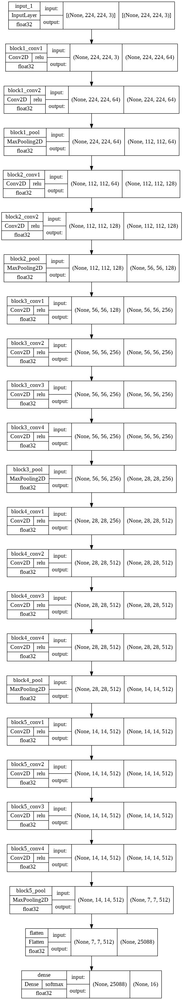

In [ ]:
visualizeModel(VGG19, name)

In [ ]:
from datetime import datetime
start_time = datetime.now()
VGG19_fit = VGG19.fit(train_batches,epochs=30,validation_data=valid_batches, steps_per_epoch= len(train_batches), validation_steps= len(valid_batches))
end_time = datetime.now()

Epoch 1/30
805/805 [==============================] - 130s 161ms/step - loss: 2.5687 - accuracy: 0.9264 - val_loss: 1.5292 - val_accuracy: 0.9611
Epoch 2/30
805/805 [==============================] - 132s 164ms/step - loss: 0.7460 - accuracy: 0.9814 - val_loss: 1.2756 - val_accuracy: 0.9761
Epoch 3/30
805/805 [==============================] - 131s 163ms/step - loss: 0.5930 - accuracy: 0.9867 - val_loss: 1.7026 - val_accuracy: 0.9749
Epoch 4/30
805/805 [==============================] - 133s 165ms/step - loss: 0.5217 - accuracy: 0.9893 - val_loss: 1.7593 - val_accuracy: 0.9776
Epoch 5/30
805/805 [==============================] - 132s 164ms/step - loss: 0.4976 - accuracy: 0.9912 - val_loss: 1.2050 - val_accuracy: 0.9853
Epoch 6/30
805/805 [==============================] - 134s 166ms/step - loss: 0.3215 - accuracy: 0.9941 - val_loss: 1.6626 - val_accuracy: 0.9817
Epoch 7/30
805/805 [==============================] - 132s 164ms/step - loss: 0.3851 - accuracy: 0.9943 - val_loss: 1.8386 -

In [ ]:
import numpy as np
SaveHistory(VGG19_fit, name)

In [ ]:
VGG19_history = LoadHistory(name)

In [ ]:
print('Total Training Time: {}'.format(end_time - start_time))

print()

print("Last Trainig Accuracy = ")
print(VGG19_history['accuracy'][-1])

print()

print("Last Validation Accuracy = ")
print(VGG19_history['val_accuracy'][-1])

Total Training Time: 1:05:59.657435

Last Trainig Accuracy = 
0.9992624521255493

Last Testing Accuracy = 
0.9887228012084961


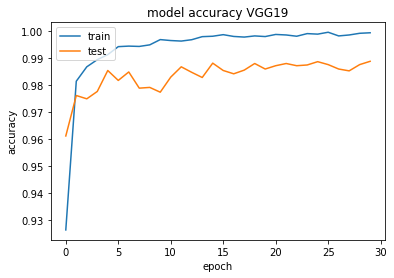

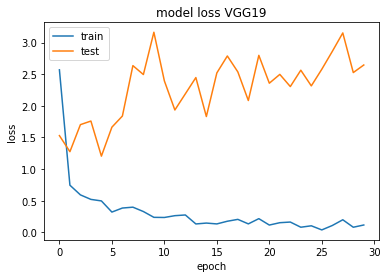

In [ ]:
accuracyLoss(VGG19_history, name)

In [ ]:
SavingEntirety(VGG19, name)

In [ ]:
loaded_VGG19 = LoadingEntirety(name)

115/115 [==============================] - 139s 1s/step
Confusion matrix, without normalization
[[229   0   0   0   0   0   0   1   0   0   0   0   0   0   0   0]
 [  1 224   0   0   0   0   4   0   0   0   0   1   0   0   0   0]
 [  0   1 228   0   0   0   0   0   0   1   0   0   0   0   0   0]
 [  0   0   0 227   0   1   0   0   0   0   0   0   1   0   1   0]
 [  0   0   0   0 230   0   0   0   0   0   0   0   0   0   0   0]
 [  1   0   0   0   0 227   0   1   0   0   0   1   0   0   0   0]
 [  0   0   0   0   0   0 229   0   0   0   0   0   0   1   0   0]
 [  0   0   0   0   0   1   0 228   0   0   1   0   0   0   0   0]
 [  0   0   0   0   0   0   1   0 229   0   0   0   0   0   0   0]
 [  0   0   1   0   0   0   0   0   0 227   0   0   0   2   0   0]
 [  0   0   0   0   0   1   0   4   0   0 225   0   0   0   0   0]
 [  0   4   0   0   0   1   0   1   0   1   0 215   0   6   1   1]
 [  0   0   0   0   0   0   0   0   0   0   0   0 229   0   0   1]
 [  0   0   0   0   0   0   0   1

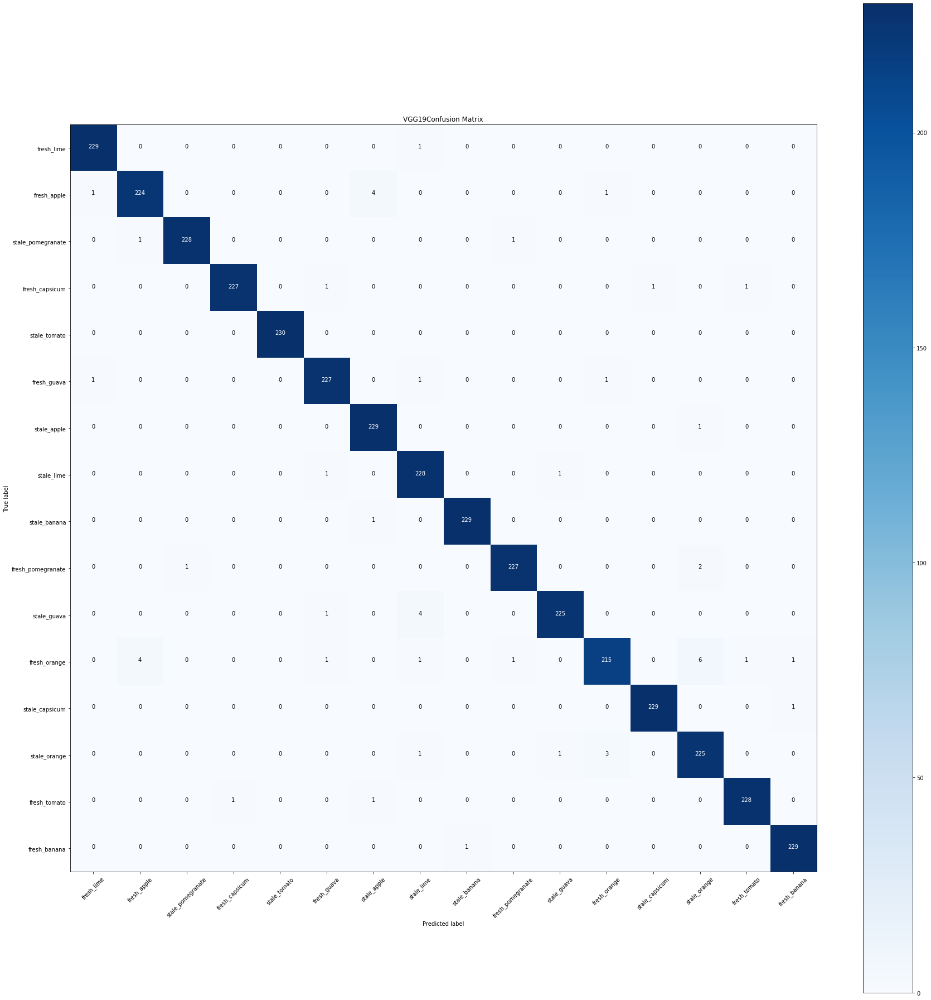

In [ ]:
ConfusionMatrix(loaded_VGG19, name)

In [ ]:
ROC_AUC, Classification_Report = ROC_AUC_Classification_Report(loaded_VGG19, name)

115/115 [==============================] - 138s 1s/step


In [ ]:
print(f"    ROC-AUC Score:      {ROC_AUC}\n")

    ROC-AUC Score:      0.9942586247637051



In [ ]:
print(Classification_Report)

                   precision    recall  f1-score   support

       fresh_lime       0.99      1.00      0.99       230
      fresh_apple       0.98      0.97      0.98       230
stale_pomegranate       1.00      0.99      0.99       230
   fresh_capsicum       1.00      0.99      0.99       230
     stale_tomato       1.00      1.00      1.00       230
      fresh_guava       0.98      0.99      0.98       230
      stale_apple       0.97      1.00      0.98       230
       stale_lime       0.97      0.99      0.98       230
     stale_banana       1.00      1.00      1.00       230
fresh_pomegranate       0.99      0.99      0.99       230
      stale_guava       0.99      0.98      0.98       230
     fresh_orange       0.98      0.93      0.96       230
   stale_capsicum       1.00      1.00      1.00       230
     stale_orange       0.96      0.98      0.97       230
     fresh_tomato       0.99      0.99      0.99       230
     fresh_banana       0.99      1.00      0.99       

115/115 [==============================] - 39s 342ms/step


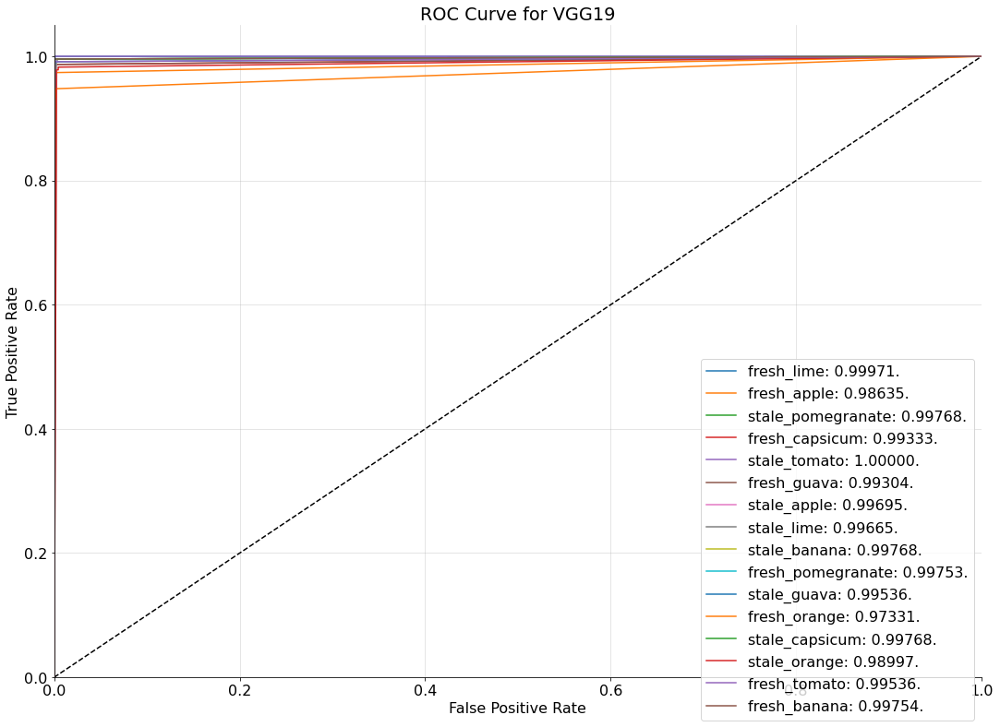

In [ ]:
plot_roc_curve(loaded_VGG19 ,name)

In [ ]:
TestAccuracy = TestingAccuracy(loaded_VGG19, name)
print(f"    Test Accuracy:      {TestAccuracy}\n")

115/115 [==============================] - 36s 315ms/step
    Test Accuracy:      0.9861413043478261



# **EfficientNetV2L**

In [ ]:
from tensorflow.keras.layers import Input, Lambda, Dense, Flatten
from tensorflow.keras.models import Model
from tensorflow.keras.applications.efficientnet_v2 import EfficientNetV2L
from tensorflow.keras.models import Sequential
import numpy as np
from glob import glob
import matplotlib.pyplot as plt

IMAGE_SIZE = [224, 224]

EfficientNetV2L = EfficientNetV2L(input_shape=IMAGE_SIZE + [3], weights='imagenet', include_top=False)

for layer in EfficientNetV2L.layers:
    layer.trainable = False

x = Flatten()(EfficientNetV2L.output)

prediction = Dense(len(classe_labels), activation='softmax')(x)

EFFICIENTNETV2L = Model(inputs=EfficientNetV2L.input, outputs=prediction)

EFFICIENTNETV2L.compile(
  loss='categorical_crossentropy',
  optimizer='adam',
  metrics=['accuracy']
)

473186304/473176280 [==============================] - 7s 0us/step


In [ ]:
EFFICIENTNETV2L.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling (Rescaling)          (None, 224, 224, 3)  0           ['input_2[0][0]']                
                                                                                                  
 stem_conv (Conv2D)             (None, 112, 112, 32  864         ['rescaling[0][0]']              
                                )                                                                 
                                                                                              

 block2a_project_conv (Conv2D)  (None, 56, 56, 64)   8192        ['block2a_expand_activation[0][0]
                                                                 ']                               
                                                                                                  
 block2a_project_bn (BatchNorma  (None, 56, 56, 64)  256         ['block2a_project_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 block2b_expand_conv (Conv2D)   (None, 56, 56, 256)  147456      ['block2a_project_bn[0][0]']     
                                                                                                  
 block2b_expand_bn (BatchNormal  (None, 56, 56, 256)  1024       ['block2b_expand_conv[0][0]']    
 ization)                                                                                         
          

                                                                                                  
 block2f_expand_bn (BatchNormal  (None, 56, 56, 256)  1024       ['block2f_expand_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 block2f_expand_activation (Act  (None, 56, 56, 256)  0          ['block2f_expand_bn[0][0]']      
 ivation)                                                                                         
                                                                                                  
 block2f_project_conv (Conv2D)  (None, 56, 56, 64)   16384       ['block2f_expand_activation[0][0]
                                                                 ']                               
                                                                                                  
 block2f_p

                                                                                                  
 block3c_drop (Dropout)         (None, 28, 28, 96)   0           ['block3c_project_bn[0][0]']     
                                                                                                  
 block3c_add (Add)              (None, 28, 28, 96)   0           ['block3c_drop[0][0]',           
                                                                  'block3b_add[0][0]']            
                                                                                                  
 block3d_expand_conv (Conv2D)   (None, 28, 28, 384)  331776      ['block3c_add[0][0]']            
                                                                                                  
 block3d_expand_bn (BatchNormal  (None, 28, 28, 384)  1536       ['block3d_expand_conv[0][0]']    
 ization)                                                                                         
          

                                                                                                  
 block4a_expand_bn (BatchNormal  (None, 28, 28, 384)  1536       ['block4a_expand_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 block4a_expand_activation (Act  (None, 28, 28, 384)  0          ['block4a_expand_bn[0][0]']      
 ivation)                                                                                         
                                                                                                  
 block4a_dwconv2 (DepthwiseConv  (None, 14, 14, 384)  3456       ['block4a_expand_activation[0][0]
 2D)                                                             ']                               
                                                                                                  
 block4a_b

 block4c_bn (BatchNormalization  (None, 14, 14, 768)  3072       ['block4c_dwconv2[0][0]']        
 )                                                                                                
                                                                                                  
 block4c_activation (Activation  (None, 14, 14, 768)  0          ['block4c_bn[0][0]']             
 )                                                                                                
                                                                                                  
 block4c_se_squeeze (GlobalAver  (None, 768)         0           ['block4c_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block4c_se_reshape (Reshape)   (None, 1, 1, 768)    0           ['block4c_se_squeeze[0][0]']     
          

                                                                                                  
 block4e_se_squeeze (GlobalAver  (None, 768)         0           ['block4e_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block4e_se_reshape (Reshape)   (None, 1, 1, 768)    0           ['block4e_se_squeeze[0][0]']     
                                                                                                  
 block4e_se_reduce (Conv2D)     (None, 1, 1, 48)     36912       ['block4e_se_reshape[0][0]']     
                                                                                                  
 block4e_se_expand (Conv2D)     (None, 1, 1, 768)    37632       ['block4e_se_reduce[0][0]']      
                                                                                                  
 block4e_s

                                                                                                  
 block4g_se_reduce (Conv2D)     (None, 1, 1, 48)     36912       ['block4g_se_reshape[0][0]']     
                                                                                                  
 block4g_se_expand (Conv2D)     (None, 1, 1, 768)    37632       ['block4g_se_reduce[0][0]']      
                                                                                                  
 block4g_se_excite (Multiply)   (None, 14, 14, 768)  0           ['block4g_activation[0][0]',     
                                                                  'block4g_se_expand[0][0]']      
                                                                                                  
 block4g_project_conv (Conv2D)  (None, 14, 14, 192)  147456      ['block4g_se_excite[0][0]']      
                                                                                                  
 block4g_p

 block4i_se_excite (Multiply)   (None, 14, 14, 768)  0           ['block4i_activation[0][0]',     
                                                                  'block4i_se_expand[0][0]']      
                                                                                                  
 block4i_project_conv (Conv2D)  (None, 14, 14, 192)  147456      ['block4i_se_excite[0][0]']      
                                                                                                  
 block4i_project_bn (BatchNorma  (None, 14, 14, 192)  768        ['block4i_project_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 block4i_drop (Dropout)         (None, 14, 14, 192)  0           ['block4i_project_bn[0][0]']     
                                                                                                  
 block4i_a

                                                                                                  
 block5a_project_bn (BatchNorma  (None, 14, 14, 224)  896        ['block5a_project_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 block5b_expand_conv (Conv2D)   (None, 14, 14, 1344  301056      ['block5a_project_bn[0][0]']     
                                )                                                                 
                                                                                                  
 block5b_expand_bn (BatchNormal  (None, 14, 14, 1344  5376       ['block5b_expand_conv[0][0]']    
 ization)                       )                                                                 
                                                                                                  
 block5b_e

                                                                                                  
 block5d_expand_conv (Conv2D)   (None, 14, 14, 1344  301056      ['block5c_add[0][0]']            
                                )                                                                 
                                                                                                  
 block5d_expand_bn (BatchNormal  (None, 14, 14, 1344  5376       ['block5d_expand_conv[0][0]']    
 ization)                       )                                                                 
                                                                                                  
 block5d_expand_activation (Act  (None, 14, 14, 1344  0          ['block5d_expand_bn[0][0]']      
 ivation)                       )                                                                 
                                                                                                  
 block5d_d

                                                                                                  
 block5f_expand_bn (BatchNormal  (None, 14, 14, 1344  5376       ['block5f_expand_conv[0][0]']    
 ization)                       )                                                                 
                                                                                                  
 block5f_expand_activation (Act  (None, 14, 14, 1344  0          ['block5f_expand_bn[0][0]']      
 ivation)                       )                                                                 
                                                                                                  
 block5f_dwconv2 (DepthwiseConv  (None, 14, 14, 1344  12096      ['block5f_expand_activation[0][0]
 2D)                            )                                ']                               
                                                                                                  
 block5f_b

                                                                                                  
 block5h_expand_activation (Act  (None, 14, 14, 1344  0          ['block5h_expand_bn[0][0]']      
 ivation)                       )                                                                 
                                                                                                  
 block5h_dwconv2 (DepthwiseConv  (None, 14, 14, 1344  12096      ['block5h_expand_activation[0][0]
 2D)                            )                                ']                               
                                                                                                  
 block5h_bn (BatchNormalization  (None, 14, 14, 1344  5376       ['block5h_dwconv2[0][0]']        
 )                              )                                                                 
                                                                                                  
 block5h_a

                                                                                                  
 block5j_dwconv2 (DepthwiseConv  (None, 14, 14, 1344  12096      ['block5j_expand_activation[0][0]
 2D)                            )                                ']                               
                                                                                                  
 block5j_bn (BatchNormalization  (None, 14, 14, 1344  5376       ['block5j_dwconv2[0][0]']        
 )                              )                                                                 
                                                                                                  
 block5j_activation (Activation  (None, 14, 14, 1344  0          ['block5j_bn[0][0]']             
 )                              )                                                                 
                                                                                                  
 block5j_s

                                                                                                  
 block5l_bn (BatchNormalization  (None, 14, 14, 1344  5376       ['block5l_dwconv2[0][0]']        
 )                              )                                                                 
                                                                                                  
 block5l_activation (Activation  (None, 14, 14, 1344  0          ['block5l_bn[0][0]']             
 )                              )                                                                 
                                                                                                  
 block5l_se_squeeze (GlobalAver  (None, 1344)        0           ['block5l_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block5l_s

                                                                                                  
 block5n_activation (Activation  (None, 14, 14, 1344  0          ['block5n_bn[0][0]']             
 )                              )                                                                 
                                                                                                  
 block5n_se_squeeze (GlobalAver  (None, 1344)        0           ['block5n_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block5n_se_reshape (Reshape)   (None, 1, 1, 1344)   0           ['block5n_se_squeeze[0][0]']     
                                                                                                  
 block5n_se_reduce (Conv2D)     (None, 1, 1, 56)     75320       ['block5n_se_reshape[0][0]']     
          

                                                                                                  
 block5p_se_squeeze (GlobalAver  (None, 1344)        0           ['block5p_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block5p_se_reshape (Reshape)   (None, 1, 1, 1344)   0           ['block5p_se_squeeze[0][0]']     
                                                                                                  
 block5p_se_reduce (Conv2D)     (None, 1, 1, 56)     75320       ['block5p_se_reshape[0][0]']     
                                                                                                  
 block5p_se_expand (Conv2D)     (None, 1, 1, 1344)   76608       ['block5p_se_reduce[0][0]']      
                                                                                                  
 block5p_s

                                                                                                  
 block5r_se_reshape (Reshape)   (None, 1, 1, 1344)   0           ['block5r_se_squeeze[0][0]']     
                                                                                                  
 block5r_se_reduce (Conv2D)     (None, 1, 1, 56)     75320       ['block5r_se_reshape[0][0]']     
                                                                                                  
 block5r_se_expand (Conv2D)     (None, 1, 1, 1344)   76608       ['block5r_se_reduce[0][0]']      
                                                                                                  
 block5r_se_excite (Multiply)   (None, 14, 14, 1344  0           ['block5r_activation[0][0]',     
                                )                                 'block5r_se_expand[0][0]']      
                                                                                                  
 block5r_p

 block6a_se_reduce (Conv2D)     (None, 1, 1, 56)     75320       ['block6a_se_reshape[0][0]']     
                                                                                                  
 block6a_se_expand (Conv2D)     (None, 1, 1, 1344)   76608       ['block6a_se_reduce[0][0]']      
                                                                                                  
 block6a_se_excite (Multiply)   (None, 7, 7, 1344)   0           ['block6a_activation[0][0]',     
                                                                  'block6a_se_expand[0][0]']      
                                                                                                  
 block6a_project_conv (Conv2D)  (None, 7, 7, 384)    516096      ['block6a_se_excite[0][0]']      
                                                                                                  
 block6a_project_bn (BatchNorma  (None, 7, 7, 384)   1536        ['block6a_project_conv[0][0]']   
 lization)

 lization)                                                                                        
                                                                                                  
 block6c_drop (Dropout)         (None, 7, 7, 384)    0           ['block6c_project_bn[0][0]']     
                                                                                                  
 block6c_add (Add)              (None, 7, 7, 384)    0           ['block6c_drop[0][0]',           
                                                                  'block6b_add[0][0]']            
                                                                                                  
 block6d_expand_conv (Conv2D)   (None, 7, 7, 2304)   884736      ['block6c_add[0][0]']            
                                                                                                  
 block6d_expand_bn (BatchNormal  (None, 7, 7, 2304)  9216        ['block6d_expand_conv[0][0]']    
 ization) 

                                                                  'block6d_add[0][0]']            
                                                                                                  
 block6f_expand_conv (Conv2D)   (None, 7, 7, 2304)   884736      ['block6e_add[0][0]']            
                                                                                                  
 block6f_expand_bn (BatchNormal  (None, 7, 7, 2304)  9216        ['block6f_expand_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 block6f_expand_activation (Act  (None, 7, 7, 2304)  0           ['block6f_expand_bn[0][0]']      
 ivation)                                                                                         
                                                                                                  
 block6f_d

 ization)                                                                                         
                                                                                                  
 block6h_expand_activation (Act  (None, 7, 7, 2304)  0           ['block6h_expand_bn[0][0]']      
 ivation)                                                                                         
                                                                                                  
 block6h_dwconv2 (DepthwiseConv  (None, 7, 7, 2304)  20736       ['block6h_expand_activation[0][0]
 2D)                                                             ']                               
                                                                                                  
 block6h_bn (BatchNormalization  (None, 7, 7, 2304)  9216        ['block6h_dwconv2[0][0]']        
 )                                                                                                
          

 block6j_dwconv2 (DepthwiseConv  (None, 7, 7, 2304)  20736       ['block6j_expand_activation[0][0]
 2D)                                                             ']                               
                                                                                                  
 block6j_bn (BatchNormalization  (None, 7, 7, 2304)  9216        ['block6j_dwconv2[0][0]']        
 )                                                                                                
                                                                                                  
 block6j_activation (Activation  (None, 7, 7, 2304)  0           ['block6j_bn[0][0]']             
 )                                                                                                
                                                                                                  
 block6j_se_squeeze (GlobalAver  (None, 2304)        0           ['block6j_activation[0][0]']     
 agePoolin

                                                                                                  
 block6l_activation (Activation  (None, 7, 7, 2304)  0           ['block6l_bn[0][0]']             
 )                                                                                                
                                                                                                  
 block6l_se_squeeze (GlobalAver  (None, 2304)        0           ['block6l_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block6l_se_reshape (Reshape)   (None, 1, 1, 2304)   0           ['block6l_se_squeeze[0][0]']     
                                                                                                  
 block6l_se_reduce (Conv2D)     (None, 1, 1, 96)     221280      ['block6l_se_reshape[0][0]']     
          

 agePooling2D)                                                                                    
                                                                                                  
 block6n_se_reshape (Reshape)   (None, 1, 1, 2304)   0           ['block6n_se_squeeze[0][0]']     
                                                                                                  
 block6n_se_reduce (Conv2D)     (None, 1, 1, 96)     221280      ['block6n_se_reshape[0][0]']     
                                                                                                  
 block6n_se_expand (Conv2D)     (None, 1, 1, 2304)   223488      ['block6n_se_reduce[0][0]']      
                                                                                                  
 block6n_se_excite (Multiply)   (None, 7, 7, 2304)   0           ['block6n_activation[0][0]',     
                                                                  'block6n_se_expand[0][0]']      
          

                                                                                                  
 block6p_se_expand (Conv2D)     (None, 1, 1, 2304)   223488      ['block6p_se_reduce[0][0]']      
                                                                                                  
 block6p_se_excite (Multiply)   (None, 7, 7, 2304)   0           ['block6p_activation[0][0]',     
                                                                  'block6p_se_expand[0][0]']      
                                                                                                  
 block6p_project_conv (Conv2D)  (None, 7, 7, 384)    884736      ['block6p_se_excite[0][0]']      
                                                                                                  
 block6p_project_bn (BatchNorma  (None, 7, 7, 384)   1536        ['block6p_project_conv[0][0]']   
 lization)                                                                                        
          

                                                                                                  
 block6r_project_conv (Conv2D)  (None, 7, 7, 384)    884736      ['block6r_se_excite[0][0]']      
                                                                                                  
 block6r_project_bn (BatchNorma  (None, 7, 7, 384)   1536        ['block6r_project_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 block6r_drop (Dropout)         (None, 7, 7, 384)    0           ['block6r_project_bn[0][0]']     
                                                                                                  
 block6r_add (Add)              (None, 7, 7, 384)    0           ['block6r_drop[0][0]',           
                                                                  'block6q_add[0][0]']            
          

                                                                                                  
 block6t_drop (Dropout)         (None, 7, 7, 384)    0           ['block6t_project_bn[0][0]']     
                                                                                                  
 block6t_add (Add)              (None, 7, 7, 384)    0           ['block6t_drop[0][0]',           
                                                                  'block6s_add[0][0]']            
                                                                                                  
 block6u_expand_conv (Conv2D)   (None, 7, 7, 2304)   884736      ['block6t_add[0][0]']            
                                                                                                  
 block6u_expand_bn (BatchNormal  (None, 7, 7, 2304)  9216        ['block6u_expand_conv[0][0]']    
 ization)                                                                                         
          

                                                                                                  
 block6w_expand_conv (Conv2D)   (None, 7, 7, 2304)   884736      ['block6v_add[0][0]']            
                                                                                                  
 block6w_expand_bn (BatchNormal  (None, 7, 7, 2304)  9216        ['block6w_expand_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 block6w_expand_activation (Act  (None, 7, 7, 2304)  0           ['block6w_expand_bn[0][0]']      
 ivation)                                                                                         
                                                                                                  
 block6w_dwconv2 (DepthwiseConv  (None, 7, 7, 2304)  20736       ['block6w_expand_activation[0][0]
 2D)      

                                                                                                  
 block6y_expand_activation (Act  (None, 7, 7, 2304)  0           ['block6y_expand_bn[0][0]']      
 ivation)                                                                                         
                                                                                                  
 block6y_dwconv2 (DepthwiseConv  (None, 7, 7, 2304)  20736       ['block6y_expand_activation[0][0]
 2D)                                                             ']                               
                                                                                                  
 block6y_bn (BatchNormalization  (None, 7, 7, 2304)  9216        ['block6y_dwconv2[0][0]']        
 )                                                                                                
                                                                                                  
 block6y_a

 block7b_activation (Activation  (None, 7, 7, 3840)  0           ['block7b_bn[0][0]']             
 )                                                                                                
                                                                                                  
 block7b_se_squeeze (GlobalAver  (None, 3840)        0           ['block7b_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block7b_se_reshape (Reshape)   (None, 1, 1, 3840)   0           ['block7b_se_squeeze[0][0]']     
                                                                                                  
 block7b_se_reduce (Conv2D)     (None, 1, 1, 160)    614560      ['block7b_se_reshape[0][0]']     
                                                                                                  
 block7b_s

                                                                                                  
 block7d_se_reshape (Reshape)   (None, 1, 1, 3840)   0           ['block7d_se_squeeze[0][0]']     
                                                                                                  
 block7d_se_reduce (Conv2D)     (None, 1, 1, 160)    614560      ['block7d_se_reshape[0][0]']     
                                                                                                  
 block7d_se_expand (Conv2D)     (None, 1, 1, 3840)   618240      ['block7d_se_reduce[0][0]']      
                                                                                                  
 block7d_se_excite (Multiply)   (None, 7, 7, 3840)   0           ['block7d_activation[0][0]',     
                                                                  'block7d_se_expand[0][0]']      
                                                                                                  
 block7d_p

 block7f_se_expand (Conv2D)     (None, 1, 1, 3840)   618240      ['block7f_se_reduce[0][0]']      
                                                                                                  
 block7f_se_excite (Multiply)   (None, 7, 7, 3840)   0           ['block7f_activation[0][0]',     
                                                                  'block7f_se_expand[0][0]']      
                                                                                                  
 block7f_project_conv (Conv2D)  (None, 7, 7, 640)    2457600     ['block7f_se_excite[0][0]']      
                                                                                                  
 block7f_project_bn (BatchNorma  (None, 7, 7, 640)   2560        ['block7f_project_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 block7f_d

In [ ]:
name = "EFFICIENTNETV2L"

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.242073 to fit



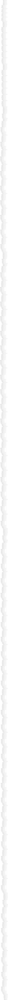

In [ ]:
visualizeModel(EFFICIENTNETV2L, name)

In [ ]:
from datetime import datetime
start_time = datetime.now()
EFFICIENTNETV2L_fit = EFFICIENTNETV2L.fit(train_batches,epochs=30,validation_data=valid_batches, steps_per_epoch= len(train_batches), validation_steps= len(valid_batches))
end_time = datetime.now()

Epoch 1/30
805/805 [==============================] - 165s 192ms/step - loss: 1.5733 - accuracy: 0.8305 - val_loss: 1.1520 - val_accuracy: 0.9038
Epoch 2/30
805/805 [==============================] - 151s 187ms/step - loss: 0.9309 - accuracy: 0.9194 - val_loss: 0.8124 - val_accuracy: 0.9345
Epoch 3/30
805/805 [==============================] - 150s 186ms/step - loss: 0.7349 - accuracy: 0.9401 - val_loss: 0.8142 - val_accuracy: 0.9477
Epoch 4/30
805/805 [==============================] - 151s 188ms/step - loss: 0.6773 - accuracy: 0.9505 - val_loss: 1.0037 - val_accuracy: 0.9450
Epoch 5/30
805/805 [==============================] - 149s 186ms/step - loss: 0.6407 - accuracy: 0.9563 - val_loss: 0.9774 - val_accuracy: 0.9481
Epoch 6/30
805/805 [==============================] - 151s 187ms/step - loss: 0.5564 - accuracy: 0.9613 - val_loss: 0.9749 - val_accuracy: 0.9512
Epoch 7/30
805/805 [==============================] - 152s 188ms/step - loss: 0.5045 - accuracy: 0.9664 - val_loss: 0.9272 -

In [ ]:
import numpy as np
SaveHistory(EFFICIENTNETV2L_fit, name)

In [ ]:
EFFICIENTNETV2L_history = LoadHistory(name)

In [ ]:
print('Total Training Time: {}'.format(end_time - start_time))

print()

print("Last Trainig Accuracy = ")
print(EFFICIENTNETV2L_history['accuracy'][-1])

print()

print("Last Validation Accuracy = ")
print(EFFICIENTNETV2L_history['val_accuracy'][-1])

Total Training Time: 1:15:26.238795

Last Trainig Accuracy = 
0.9900621175765991

Last Testing Accuracy = 
0.971875011920929


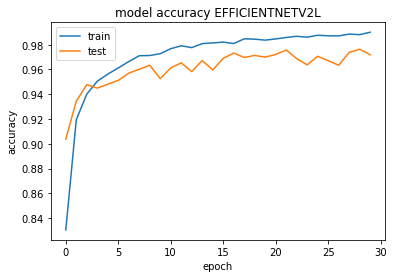

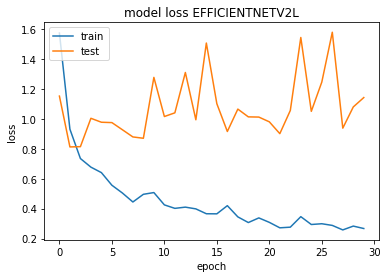

In [ ]:
accuracyLoss(EFFICIENTNETV2L_history, name)

In [ ]:
SavingEntirety(EFFICIENTNETV2L, name)

In [ ]:
loaded_EFFICIENTNETV2L = LoadingEntirety(name)

115/115 [==============================] - 205s 2s/step
Confusion matrix, without normalization
[[227   0   0   0   0   3   0   0   0   0   0   0   0   0   0   0]
 [  0 214   1   1   0   1   6   1   0   1   0   3   0   0   1   1]
 [  0   0 224   0   0   3   0   2   0   0   1   0   0   0   0   0]
 [  0   0   0 226   0   2   1   0   0   0   0   0   1   0   0   0]
 [  0   0   0   1 223   0   1   0   2   0   1   0   0   0   2   0]
 [  1   0   0   0   0 226   0   1   0   0   2   0   0   0   0   0]
 [  0   7   0   0   0   0 222   0   0   0   0   0   0   1   0   0]
 [  0   0   0   0   0   1   0 227   0   0   2   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0 227   0   0   0   0   1   0   2]
 [  0   1   0   1   0   0   0   0   0 227   0   0   0   1   0   0]
 [  0   0   1   0   0   2   0   2   0   0 225   0   0   0   0   0]
 [  0   2   0   0   0   2   1   0   0   0   0 207   0  18   0   0]
 [  0   0   0   4   0   0   0   0   0   0   0   0 226   0   0   0]
 [  0   1   0   0   0   0   0   0

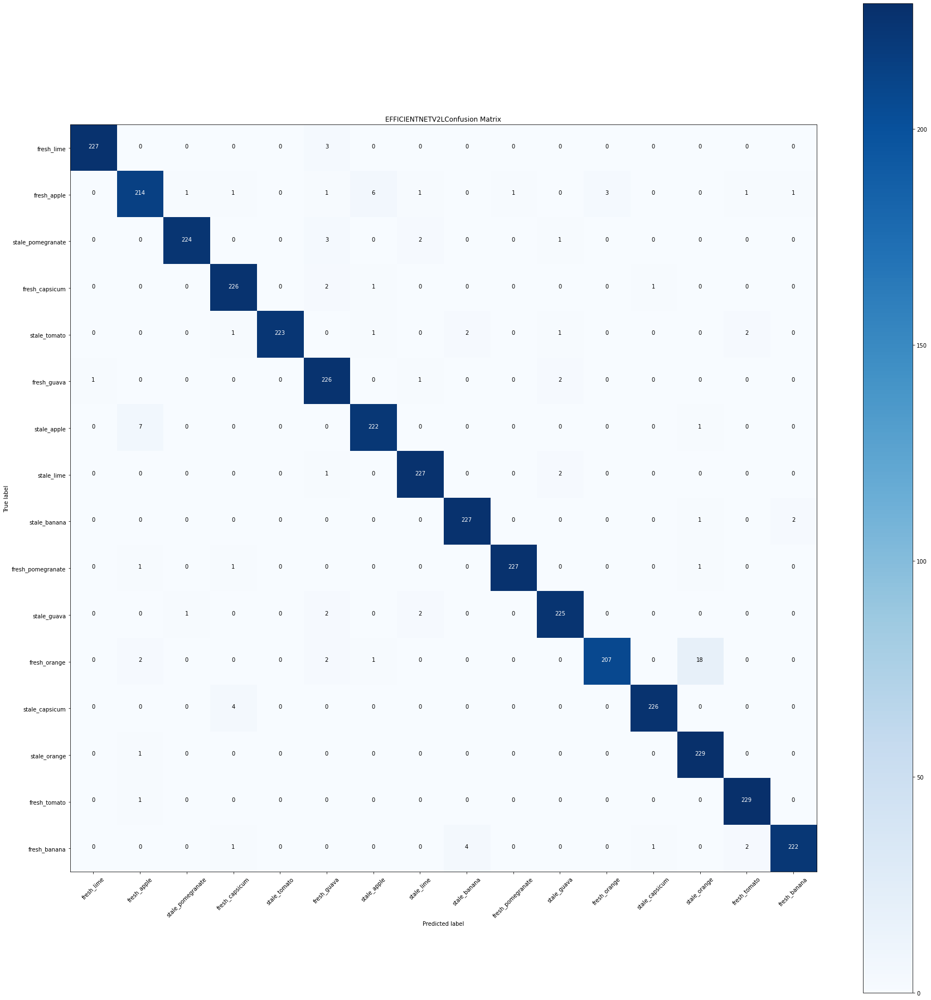

In [ ]:
ConfusionMatrix(loaded_EFFICIENTNETV2L, name)

In [ ]:
ROC_AUC, Classification_Report = ROC_AUC_Classification_Report(loaded_EFFICIENTNETV2L, name)

115/115 [==============================] - 213s 2s/step


In [ ]:
print(f"    ROC-AOC Score:      {ROC_AUC}\n")

    ROC-AOC Score:      0.9985250078764965



In [ ]:
print(Classification_Report)

                   precision    recall  f1-score   support

       fresh_lime       1.00      0.99      0.99       230
      fresh_apple       0.95      0.93      0.94       230
stale_pomegranate       0.99      0.97      0.98       230
   fresh_capsicum       0.97      0.98      0.97       230
     stale_tomato       1.00      0.97      0.98       230
      fresh_guava       0.94      0.98      0.96       230
      stale_apple       0.96      0.97      0.96       230
       stale_lime       0.97      0.99      0.98       230
     stale_banana       0.97      0.99      0.98       230
fresh_pomegranate       1.00      0.99      0.99       230
      stale_guava       0.97      0.98      0.98       230
     fresh_orange       0.99      0.90      0.94       230
   stale_capsicum       0.99      0.98      0.99       230
     stale_orange       0.92      1.00      0.95       230
     fresh_tomato       0.98      1.00      0.99       230
     fresh_banana       0.99      0.97      0.98       

115/115 [==============================] - 58s 439ms/step


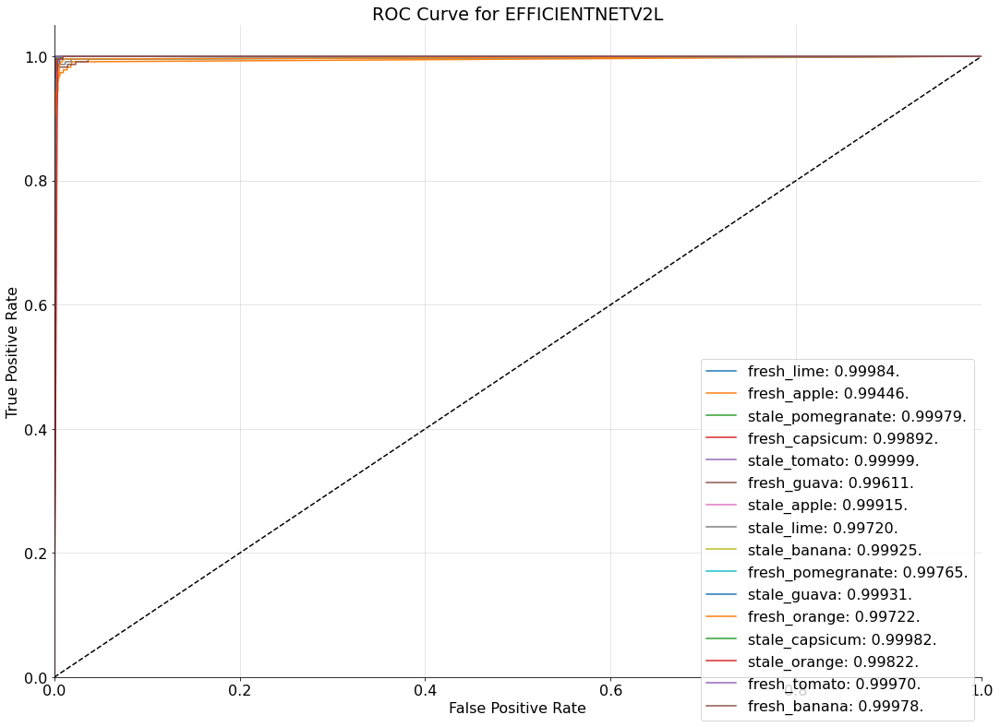

In [ ]:
plot_roc_curve(loaded_EFFICIENTNETV2L, name)

In [ ]:
TestAccuracy = TestingAccuracy(loaded_EFFICIENTNETV2L, name)
print(f"    Test Accuracy:      {TestAccuracy}\n")

115/115 [==============================] - 54s 425ms/step
    Test Accuracy:      0.9730978260869565



# **Inception V3**

In [ ]:
from tensorflow.keras.layers import Input, Lambda, Dense, Flatten
from tensorflow.keras.models import Model
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.applications.inception_v3 import preprocess_input
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator,load_img
from tensorflow.keras.models import Sequential
import numpy as np
from glob import glob
import matplotlib.pyplot as plt

IMAGE_SIZE = [224, 224]

INCEPTIONV3 = InceptionV3(input_shape=IMAGE_SIZE + [3], weights='imagenet', include_top=False)

for layer in INCEPTIONV3.layers:
    layer.trainable = False

x = Flatten()(INCEPTIONV3.output)

prediction = Dense(len(classe_labels), activation='softmax')(x)

Inception_V3 = Model(inputs=INCEPTIONV3.input, outputs=prediction)

Inception_V3.compile(
  loss='categorical_crossentropy',
  optimizer='adam',
  metrics=['accuracy']
)

87924736/87910968 [==============================] - 2s 0us/step


In [ ]:
Inception_V3.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_188 (Conv2D)            (None, 111, 111, 32  864         ['input_3[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization_188 (Batch  (None, 111, 111, 32  96         ['conv2d_188[0][0]']             
 Normalization)                 )                                                           

 batch_normalization_193 (Batch  (None, 25, 25, 64)  192         ['conv2d_193[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 batch_normalization_195 (Batch  (None, 25, 25, 64)  192         ['conv2d_195[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 batch_normalization_198 (Batch  (None, 25, 25, 96)  288         ['conv2d_198[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 batch_normalization_199 (Batch  (None, 25, 25, 32)  96          ['conv2d_199[0][0]']             
 Normaliza

                                                                                                  
 batch_normalization_210 (Batch  (None, 25, 25, 64)  192         ['conv2d_210[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 activation_210 (Activation)    (None, 25, 25, 64)   0           ['batch_normalization_210[0][0]']
                                                                                                  
 conv2d_208 (Conv2D)            (None, 25, 25, 48)   13824       ['mixed1[0][0]']                 
                                                                                                  
 conv2d_211 (Conv2D)            (None, 25, 25, 96)   55296       ['activation_210[0][0]']         
                                                                                                  
 batch_nor

                                                                                                  
 max_pooling2d_10 (MaxPooling2D  (None, 12, 12, 288)  0          ['mixed2[0][0]']                 
 )                                                                                                
                                                                                                  
 mixed3 (Concatenate)           (None, 12, 12, 768)  0           ['activation_214[0][0]',         
                                                                  'activation_217[0][0]',         
                                                                  'max_pooling2d_10[0][0]']       
                                                                                                  
 conv2d_222 (Conv2D)            (None, 12, 12, 128)  98304       ['mixed3[0][0]']                 
                                                                                                  
 batch_nor

                                                                  'activation_226[0][0]',         
                                                                  'activation_227[0][0]']         
                                                                                                  
 conv2d_232 (Conv2D)            (None, 12, 12, 160)  122880      ['mixed4[0][0]']                 
                                                                                                  
 batch_normalization_232 (Batch  (None, 12, 12, 160)  480        ['conv2d_232[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 activation_232 (Activation)    (None, 12, 12, 160)  0           ['batch_normalization_232[0][0]']
                                                                                                  
 conv2d_23

 batch_normalization_242 (Batch  (None, 12, 12, 160)  480        ['conv2d_242[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 activation_242 (Activation)    (None, 12, 12, 160)  0           ['batch_normalization_242[0][0]']
                                                                                                  
 conv2d_243 (Conv2D)            (None, 12, 12, 160)  179200      ['activation_242[0][0]']         
                                                                                                  
 batch_normalization_243 (Batch  (None, 12, 12, 160)  480        ['conv2d_243[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 activatio

 conv2d_253 (Conv2D)            (None, 12, 12, 192)  258048      ['activation_252[0][0]']         
                                                                                                  
 batch_normalization_253 (Batch  (None, 12, 12, 192)  576        ['conv2d_253[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 activation_253 (Activation)    (None, 12, 12, 192)  0           ['batch_normalization_253[0][0]']
                                                                                                  
 conv2d_249 (Conv2D)            (None, 12, 12, 192)  147456      ['mixed6[0][0]']                 
                                                                                                  
 conv2d_254 (Conv2D)            (None, 12, 12, 192)  258048      ['activation_253[0][0]']         
          

 activation_261 (Activation)    (None, 12, 12, 192)  0           ['batch_normalization_261[0][0]']
                                                                                                  
 conv2d_258 (Conv2D)            (None, 12, 12, 192)  147456      ['mixed7[0][0]']                 
                                                                                                  
 conv2d_262 (Conv2D)            (None, 12, 12, 192)  258048      ['activation_261[0][0]']         
                                                                                                  
 batch_normalization_258 (Batch  (None, 12, 12, 192)  576        ['conv2d_258[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 batch_normalization_262 (Batch  (None, 12, 12, 192)  576        ['conv2d_262[0][0]']             
 Normaliza

 conv2d_272 (Conv2D)            (None, 5, 5, 192)    245760      ['average_pooling2d_25[0][0]']   
                                                                                                  
 batch_normalization_264 (Batch  (None, 5, 5, 320)   960         ['conv2d_264[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 activation_266 (Activation)    (None, 5, 5, 384)    0           ['batch_normalization_266[0][0]']
                                                                                                  
 activation_267 (Activation)    (None, 5, 5, 384)    0           ['batch_normalization_267[0][0]']
                                                                                                  
 activation_270 (Activation)    (None, 5, 5, 384)    0           ['batch_normalization_270[0][0]']
          

                                                                                                  
 activation_276 (Activation)    (None, 5, 5, 384)    0           ['batch_normalization_276[0][0]']
                                                                                                  
 activation_279 (Activation)    (None, 5, 5, 384)    0           ['batch_normalization_279[0][0]']
                                                                                                  
 activation_280 (Activation)    (None, 5, 5, 384)    0           ['batch_normalization_280[0][0]']
                                                                                                  
 batch_normalization_281 (Batch  (None, 5, 5, 192)   576         ['conv2d_281[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 activatio

In [ ]:
name="Inception_V3"

In [ ]:
visualizeModel(Inception_V3, name)

In [ ]:
from datetime import datetime
start_time = datetime.now()
Inception_V3_fit = Inception_V3.fit(train_batches,epochs=30,validation_data=valid_batches, steps_per_epoch= len(train_batches), validation_steps= len(valid_batches))
end_time = datetime.now()

Epoch 1/30


2022-06-23 08:14:09.789921: I tensorflow/stream_executor/cuda/cuda_dnn.cc:384] Loaded cuDNN version 8100
2022-06-23 08:14:10.821930: W tensorflow/stream_executor/gpu/asm_compiler.cc:111] *** WARNING *** You are using ptxas 10.1.243, which is older than 11.1. ptxas before 11.1 is known to miscompile XLA code, leading to incorrect results or invalid-address errors.

You may not need to update to CUDA 11.1; cherry-picking the ptxas binary is often sufficient.
2022-06-23 08:14:10.823629: W tensorflow/stream_executor/gpu/asm_compiler.cc:230] Falling back to the CUDA driver for PTX compilation; ptxas does not support CC 8.6
2022-06-23 08:14:10.823657: W tensorflow/stream_executor/gpu/asm_compiler.cc:233] Used ptxas at ptxas
2022-06-23 08:14:10.823746: W tensorflow/stream_executor/gpu/redzone_allocator.cc:314] UNIMPLEMENTED: ptxas ptxas too old. Falling back to the driver to compile.
Relying on driver to perform ptx compilation. 
Modify $PATH to customize ptxas location.
This message will be 

  3/805 [..............................] - ETA: 52s - loss: 218.2038 - accuracy: 0.0833   

2022-06-23 08:14:12.037179: I tensorflow/stream_executor/cuda/cuda_blas.cc:1786] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.


805/805 [==============================] - 152s 182ms/step - loss: 77.3888 - accuracy: 0.5318 - val_loss: 73.0989 - val_accuracy: 0.6011
Epoch 2/30
805/805 [==============================] - 133s 165ms/step - loss: 46.9306 - accuracy: 0.7075 - val_loss: 61.7530 - val_accuracy: 0.6952
Epoch 3/30
805/805 [==============================] - 132s 164ms/step - loss: 37.8231 - accuracy: 0.7628 - val_loss: 62.2311 - val_accuracy: 0.7124
Epoch 4/30
805/805 [==============================] - 133s 165ms/step - loss: 33.6056 - accuracy: 0.8040 - val_loss: 66.0338 - val_accuracy: 0.7327
Epoch 5/30
805/805 [==============================] - 130s 162ms/step - loss: 28.2332 - accuracy: 0.8359 - val_loss: 128.5472 - val_accuracy: 0.6762
Epoch 6/30
805/805 [==============================] - 132s 164ms/step - loss: 24.6683 - accuracy: 0.8583 - val_loss: 64.9337 - val_accuracy: 0.7519
Epoch 7/30
805/805 [==============================] - 132s 164ms/step - loss: 20.9043 - accuracy: 0.8750 - val_loss: 76.51

In [ ]:
import numpy as np
SaveHistory(Inception_V3_fit, name)

In [ ]:
Inception_V3_history = LoadHistory(name)

In [ ]:
print('Total Training Time: {}'.format(end_time - start_time))

print()

print("Last Trainig Accuracy = ")
print(Inception_V3_history['accuracy'][-1])

print()

print("Last Validation Accuracy = ")
print(Inception_V3_history['val_accuracy'][-1])

Total Training Time: 1:06:38.497009

Last Trainig Accuracy = 
0.9682453274726868

Last Testing Accuracy = 
0.7554348111152649


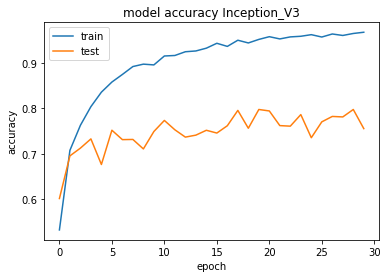

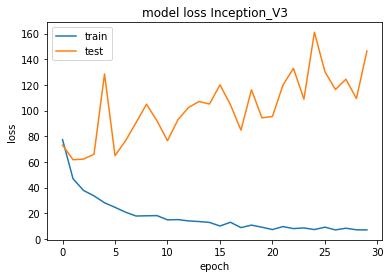

In [ ]:
accuracyLoss(Inception_V3_history, name)

In [ ]:
SavingEntirety(Inception_V3, name)

In [ ]:
loaded_Inception_V3 = LoadingEntirety(name)

115/115 [==============================] - 55s 470ms/step
Confusion matrix, without normalization
[[180   1   5   2   0   1   2  26   0   1   1   1   2   4   0   4]
 [  0 137   3   2   0   1   8   5   3   1   1   2   7  21   9  30]
 [  0   5 214   2   0   0   1   2   0   0   2   1   1   0   0   2]
 [  0   2   4 171   4   0   0   1   4   1   0   0  35   3   2   3]
 [  0   3   0   6 199   0   2   0   0   0   0   1  11   3   2   3]
 [  2  29  17   0   0 104   0  12   9  21   2   2   0   6   2  24]
 [  0  14   7   2   2   0 125   3   2   0   0   1  13  61   0   0]
 [  0   0   4   0   0   0   1 206   2   0   1   0   0  14   0   2]
 [  0   7   5   3   4   0   0   1 191   2   0   0   5   5   1   6]
 [  0   3   4   1   2   9   1   1   5 182   1   1   0   9   0  11]
 [  0   2  25   0   0   1   3   9   2   4 163   0   1  11   0   9]
 [  1  17   4   1   1   1   9   1   6   4   0 106   0  42   5  32]
 [  0   0   1   9   1   0   1   0   2   0   0   0 210   4   0   2]
 [  0   4   2   1   0   0   6  

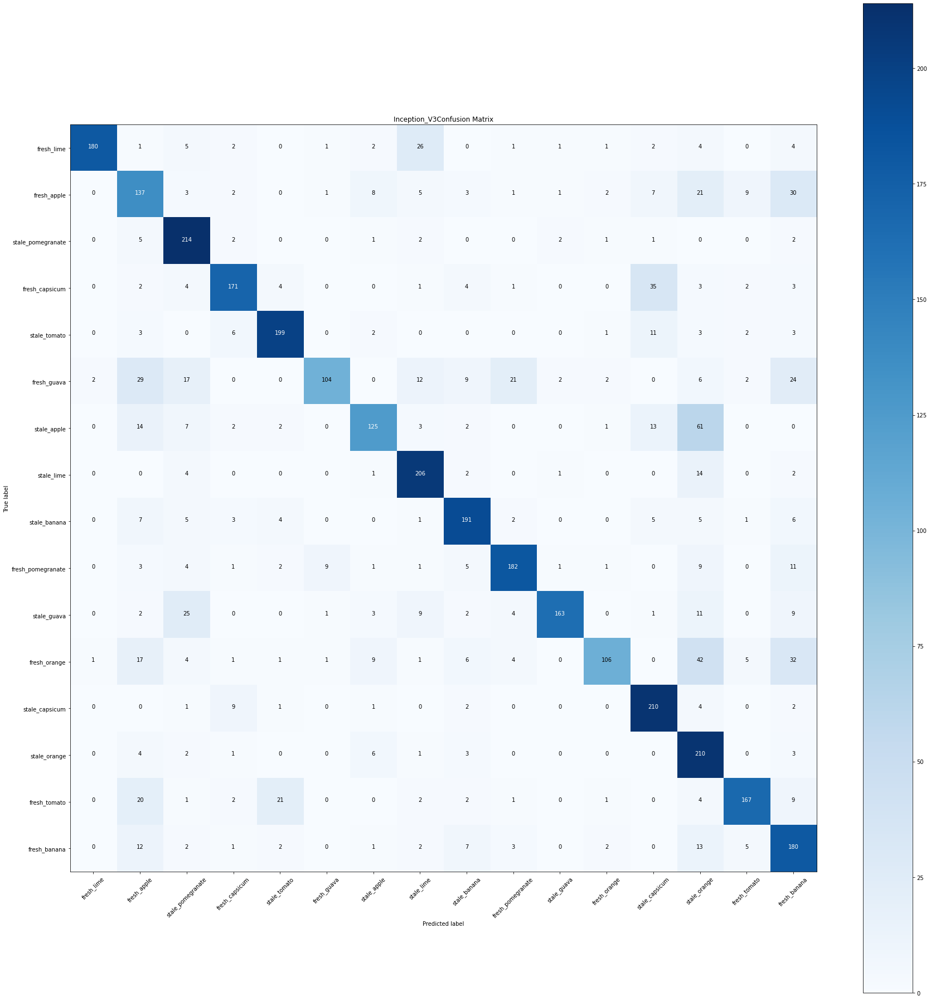

In [ ]:
ConfusionMatrix(loaded_Inception_V3, name)

In [ ]:
ROC_AUC, Classification_Report = ROC_AUC_Classification_Report(loaded_Inception_V3, name)

115/115 [==============================] - 56s 487ms/step


In [ ]:
print(f"    ROC-AUC Score:      {ROC_AUC}\n")

    ROC-AUC Score:      0.8784287177063641



In [ ]:
print(Classification_Report)

                   precision    recall  f1-score   support

       fresh_lime       0.98      0.78      0.87       230
      fresh_apple       0.54      0.60      0.56       230
stale_pomegranate       0.72      0.93      0.81       230
   fresh_capsicum       0.84      0.74      0.79       230
     stale_tomato       0.84      0.87      0.85       230
      fresh_guava       0.89      0.45      0.60       230
      stale_apple       0.78      0.54      0.64       230
       stale_lime       0.76      0.90      0.82       230
     stale_banana       0.80      0.83      0.82       230
fresh_pomegranate       0.83      0.79      0.81       230
      stale_guava       0.95      0.71      0.81       230
     fresh_orange       0.90      0.46      0.61       230
   stale_capsicum       0.74      0.91      0.82       230
     stale_orange       0.51      0.91      0.66       230
     fresh_tomato       0.87      0.73      0.79       230
     fresh_banana       0.56      0.78      0.65       

115/115 [==============================] - 36s 289ms/step


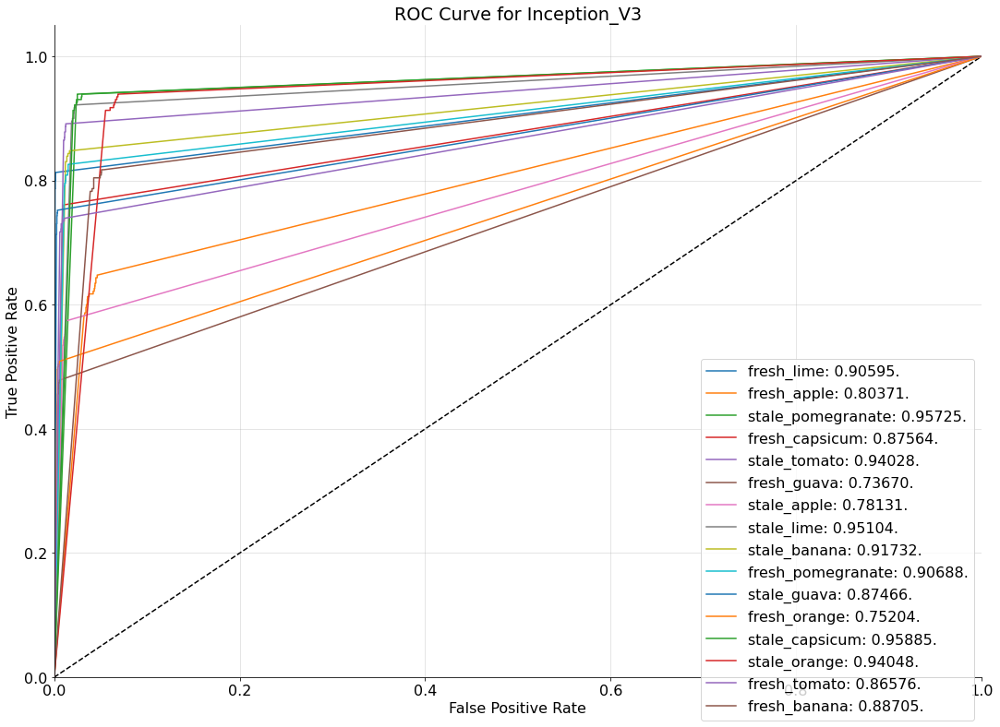

In [ ]:
plot_roc_curve(loaded_Inception_V3, name)

In [ ]:
TestAccuracy = TestingAccuracy(loaded_Inception_V3, name)
print(f"    Test Accuracy:      {TestAccuracy}\n")

115/115 [==============================] - 36s 291ms/step
    Test Accuracy:      0.7459239130434783



# **Xception**

In [ ]:
from tensorflow.keras.layers import Input, Lambda, Dense, Flatten
from tensorflow.keras.models import Model
from tensorflow.keras.applications import Xception
from tensorflow.keras.models import Sequential
import numpy as np
from glob import glob
import matplotlib.pyplot as plt

IMAGE_SIZE = [224, 224]

Xception = Xception(input_shape=IMAGE_SIZE + [3], weights='imagenet', include_top=False)

for layer in Xception.layers:
    layer.trainable = False

x = Flatten()(Xception.output)

prediction = Dense(len(classe_labels), activation='softmax')(x)

XCEPTION = Model(inputs=Xception.input, outputs=prediction)

XCEPTION.compile(
  loss='categorical_crossentropy',
  optimizer='adam',
  metrics=['accuracy']
)

83697664/83683744 [==============================] - 1s 0us/step


In [ ]:
XCEPTION.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 111, 111, 32  864         ['input_4[0][0]']                
                                )                                                                 
                                                                                                  
 block1_conv1_bn (BatchNormaliz  (None, 111, 111, 32  128        ['block1_conv1[0][0]']           
 ation)                         )                                                           

 block4_sepconv1_bn (BatchNorma  (None, 28, 28, 728)  2912       ['block4_sepconv1[0][0]']        
 lization)                                                                                        
                                                                                                  
 block4_sepconv2_act (Activatio  (None, 28, 28, 728)  0          ['block4_sepconv1_bn[0][0]']     
 n)                                                                                               
                                                                                                  
 block4_sepconv2 (SeparableConv  (None, 28, 28, 728)  536536     ['block4_sepconv2_act[0][0]']    
 2D)                                                                                              
                                                                                                  
 block4_sepconv2_bn (BatchNorma  (None, 28, 28, 728)  2912       ['block4_sepconv2[0][0]']        
 lization)

 n)                                                                                               
                                                                                                  
 block7_sepconv1 (SeparableConv  (None, 14, 14, 728)  536536     ['block7_sepconv1_act[0][0]']    
 2D)                                                                                              
                                                                                                  
 block7_sepconv1_bn (BatchNorma  (None, 14, 14, 728)  2912       ['block7_sepconv1[0][0]']        
 lization)                                                                                        
                                                                                                  
 block7_sepconv2_act (Activatio  (None, 14, 14, 728)  0          ['block7_sepconv1_bn[0][0]']     
 n)                                                                                               
          

 block9_sepconv3_bn (BatchNorma  (None, 14, 14, 728)  2912       ['block9_sepconv3[0][0]']        
 lization)                                                                                        
                                                                                                  
 add_7 (Add)                    (None, 14, 14, 728)  0           ['block9_sepconv3_bn[0][0]',     
                                                                  'add_6[0][0]']                  
                                                                                                  
 block10_sepconv1_act (Activati  (None, 14, 14, 728)  0          ['add_7[0][0]']                  
 on)                                                                                              
                                                                                                  
 block10_sepconv1 (SeparableCon  (None, 14, 14, 728)  536536     ['block10_sepconv1_act[0][0]']   
 v2D)     

                                                                                                  
 block12_sepconv3_act (Activati  (None, 14, 14, 728)  0          ['block12_sepconv2_bn[0][0]']    
 on)                                                                                              
                                                                                                  
 block12_sepconv3 (SeparableCon  (None, 14, 14, 728)  536536     ['block12_sepconv3_act[0][0]']   
 v2D)                                                                                             
                                                                                                  
 block12_sepconv3_bn (BatchNorm  (None, 14, 14, 728)  2912       ['block12_sepconv3[0][0]']       
 alization)                                                                                       
                                                                                                  
 add_10 (A

In [ ]:
name = "XCEPTION"

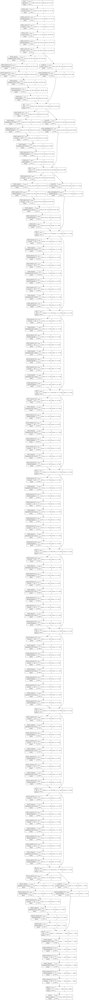

In [ ]:
visualizeModel(XCEPTION, name)

In [ ]:
from datetime import datetime
start_time = datetime.now()
XCEPTION_fit = XCEPTION.fit(train_batches,epochs=30,validation_data=valid_batches, steps_per_epoch= len(train_batches), validation_steps= len(valid_batches))
end_time = datetime.now()

Epoch 1/30
805/805 [==============================] - 135s 166ms/step - loss: 42.2771 - accuracy: 0.6082 - val_loss: 33.2629 - val_accuracy: 0.7072
Epoch 2/30
805/805 [==============================] - 133s 165ms/step - loss: 24.2918 - accuracy: 0.7778 - val_loss: 30.2905 - val_accuracy: 0.7504
Epoch 3/30
805/805 [==============================] - 131s 162ms/step - loss: 18.3401 - accuracy: 0.8360 - val_loss: 23.9433 - val_accuracy: 0.8026
Epoch 4/30
805/805 [==============================] - 131s 163ms/step - loss: 14.9038 - accuracy: 0.8661 - val_loss: 30.1817 - val_accuracy: 0.8026
Epoch 5/30
805/805 [==============================] - 133s 165ms/step - loss: 14.4764 - accuracy: 0.8814 - val_loss: 32.2939 - val_accuracy: 0.7992
Epoch 6/30
805/805 [==============================] - 132s 164ms/step - loss: 12.6759 - accuracy: 0.8955 - val_loss: 32.4088 - val_accuracy: 0.8096
Epoch 7/30
805/805 [==============================] - 134s 166ms/step - loss: 10.6697 - accuracy: 0.9114 - val_l

In [ ]:
import numpy as np
SaveHistory(XCEPTION_fit, name)

In [ ]:
XCEPTION_history = LoadHistory(name)

In [ ]:
print('Total Training Time: {}'.format(end_time - start_time))

print()

print("Last Trainig Accuracy = ")
print(XCEPTION_history['accuracy'][-1])

print()

print("Last Validation Accuracy = ")
print(XCEPTION_history['val_accuracy'][-1])

Total Training Time: 1:06:16.705699

Last Trainig Accuracy = 
0.9763198494911194

Last Testing Accuracy = 
0.8735054135322571


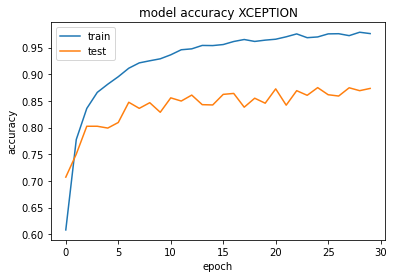

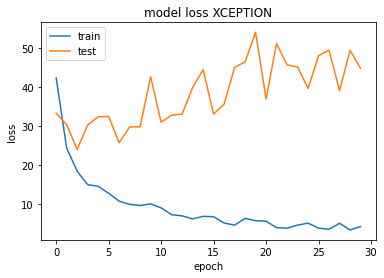

In [ ]:
accuracyLoss(XCEPTION_history, name)

In [ ]:
SavingEntirety(XCEPTION, name)

In [ ]:
loaded_XCEPTION = LoadingEntirety(name)

115/115 [==============================] - 77s 664ms/step
Confusion matrix, without normalization
[[223   0   0   0   0   2   0   2   0   1   0   0   0   2   0   0]
 [  1 179   1   1   0   5   9   0   5   1   0   9   2   8   5   4]
 [  3   3 212   0   0   1   0   1   2   0   3   0   1   1   3   0]
 [  1   2   0 182   2   0   1   1   7   0   1   1  13   0  16   3]
 [  1   0   2   1 205   0   1   0   1   0   0   2   5   0  12   0]
 [  5   3   2   0   0 203   1   3   2   0   3   2   2   2   0   2]
 [  0   6   1   2   0   1 176   2   2   0   3   2   4  28   2   1]
 [  8   1   1   0   0   4   0 211   1   0   3   0   0   1   0   0]
 [  0   0   0   4   0   7   2   4 205   0   1   2   4   0   0   1]
 [  1   0   1   0   0  15   0   0   2 207   0   1   0   1   2   0]
 [  3   1   5   0   0   1   3   3   1   0 209   0   0   4   0   0]
 [  2   6   1   0   1   1   4   0   2   0   2 201   0   8   1   1]
 [  0   2   1   6   0   1   1   0   2   0   0   0 207   0  10   0]
 [  1   2   0   0   0   1  10  

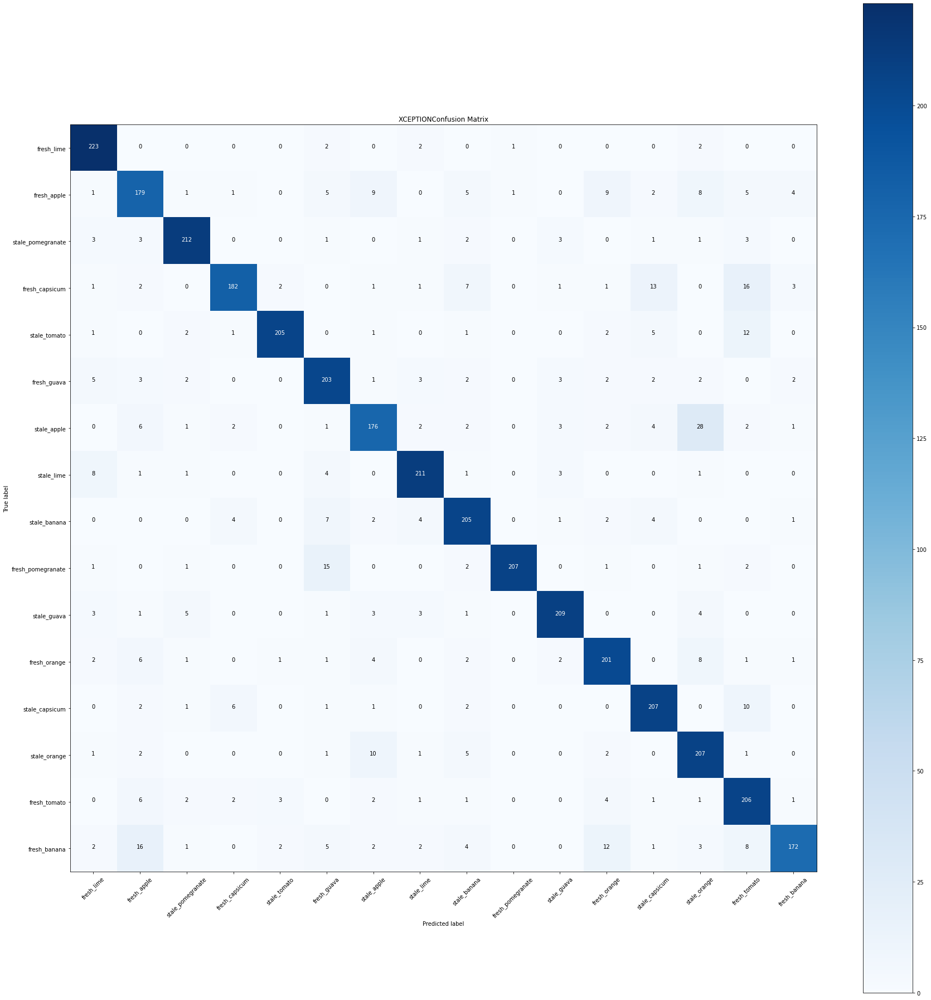

In [ ]:
ConfusionMatrix(loaded_XCEPTION, name)

In [ ]:
ROC_AUC, Classification_Report = ROC_AUC_Classification_Report(loaded_XCEPTION, name)

115/115 [==============================] - 76s 661ms/step


In [ ]:
print(f"    ROC-AUC Score:      {ROC_AUC}\n")

    ROC-AUC Score:      0.9464696361058601



In [ ]:
print(Classification_Report)

                   precision    recall  f1-score   support

       fresh_lime       0.89      0.97      0.93       230
      fresh_apple       0.79      0.78      0.78       230
stale_pomegranate       0.92      0.92      0.92       230
   fresh_capsicum       0.92      0.79      0.85       230
     stale_tomato       0.96      0.89      0.93       230
      fresh_guava       0.82      0.88      0.85       230
      stale_apple       0.83      0.77      0.80       230
       stale_lime       0.91      0.92      0.92       230
     stale_banana       0.85      0.89      0.87       230
fresh_pomegranate       0.99      0.90      0.94       230
      stale_guava       0.93      0.91      0.92       230
     fresh_orange       0.84      0.87      0.86       230
   stale_capsicum       0.86      0.90      0.88       230
     stale_orange       0.78      0.90      0.83       230
     fresh_tomato       0.77      0.90      0.83       230
     fresh_banana       0.93      0.75      0.83       

115/115 [==============================] - 36s 299ms/step


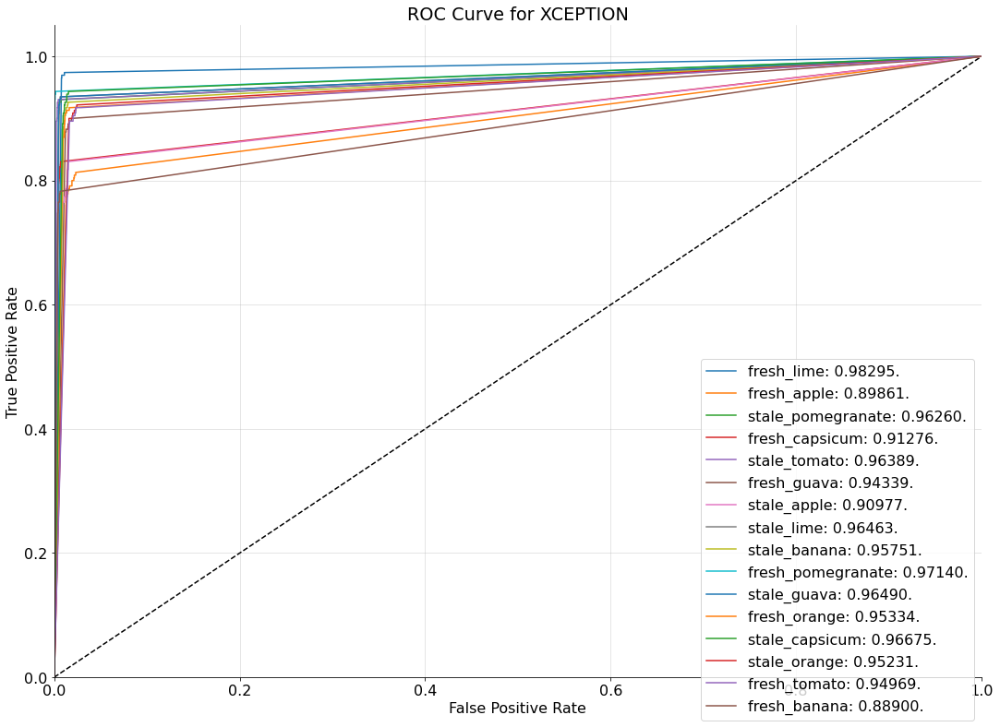

In [ ]:
plot_roc_curve(loaded_XCEPTION, name)

In [ ]:
TestAccuracy = TestingAccuracy(loaded_XCEPTION, name)
print(f"    Test Accuracy:      {TestAccuracy}\n")

115/115 [==============================] - 35s 304ms/step
    Test Accuracy:      0.8709239130434783



# **ResNet152V2**

In [ ]:
from tensorflow.keras.layers import Input, Lambda, Dense, Flatten
from tensorflow.keras.models import Model
from tensorflow.keras.applications import ResNet152V2
from tensorflow.keras.models import Sequential
import numpy as np
from glob import glob
import matplotlib.pyplot as plt

IMAGE_SIZE = [224, 224]

ResNet152V2 = ResNet152V2(input_shape=IMAGE_SIZE + [3], weights='imagenet', include_top=False)

for layer in ResNet152V2.layers:
    layer.trainable = False

x = Flatten()(ResNet152V2.output)

prediction = Dense(len(classe_labels), activation='softmax')(x)

RESNET152V2 = Model(inputs=ResNet152V2.input, outputs=prediction)

RESNET152V2.compile(
  loss='categorical_crossentropy',
  optimizer='adam',
  metrics=['accuracy']
)

234561536/234545216 [==============================] - 1s 0us/step


In [ ]:
RESNET152V2.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_5[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                            

                                                                                                  
 conv2_block3_preact_relu (Acti  (None, 56, 56, 256)  0          ['conv2_block3_preact_bn[0][0]'] 
 vation)                                                                                          
                                                                                                  
 conv2_block3_1_conv (Conv2D)   (None, 56, 56, 64)   16384       ['conv2_block3_preact_relu[0][0]'
                                                                 ]                                
                                                                                                  
 conv2_block3_1_bn (BatchNormal  (None, 56, 56, 64)  256         ['conv2_block3_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv2_blo

                                                                                                  
 conv3_block2_2_conv (Conv2D)   (None, 28, 28, 128)  147456      ['conv3_block2_2_pad[0][0]']     
                                                                                                  
 conv3_block2_2_bn (BatchNormal  (None, 28, 28, 128)  512        ['conv3_block2_2_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv3_block2_2_relu (Activatio  (None, 28, 28, 128)  0          ['conv3_block2_2_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv3_block2_3_conv (Conv2D)   (None, 28, 28, 512)  66048       ['conv3_block2_2_relu[0][0]']    
          

                                                                 ]                                
                                                                                                  
 conv3_block5_1_bn (BatchNormal  (None, 28, 28, 128)  512        ['conv3_block5_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv3_block5_1_relu (Activatio  (None, 28, 28, 128)  0          ['conv3_block5_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv3_block5_2_pad (ZeroPaddin  (None, 30, 30, 128)  0          ['conv3_block5_1_relu[0][0]']    
 g2D)                                                                                             
          

 conv3_block7_out (Add)         (None, 28, 28, 512)  0           ['conv3_block6_out[0][0]',       
                                                                  'conv3_block7_3_conv[0][0]']    
                                                                                                  
 conv3_block8_preact_bn (BatchN  (None, 28, 28, 512)  2048       ['conv3_block7_out[0][0]']       
 ormalization)                                                                                    
                                                                                                  
 conv3_block8_preact_relu (Acti  (None, 28, 28, 512)  0          ['conv3_block8_preact_bn[0][0]'] 
 vation)                                                                                          
                                                                                                  
 conv3_block8_1_conv (Conv2D)   (None, 28, 28, 128)  65536       ['conv3_block8_preact_relu[0][0]'
          

                                                                                                  
 conv4_block2_1_relu (Activatio  (None, 14, 14, 256)  0          ['conv4_block2_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv4_block2_2_pad (ZeroPaddin  (None, 16, 16, 256)  0          ['conv4_block2_1_relu[0][0]']    
 g2D)                                                                                             
                                                                                                  
 conv4_block2_2_conv (Conv2D)   (None, 14, 14, 256)  589824      ['conv4_block2_2_pad[0][0]']     
                                                                                                  
 conv4_block2_2_bn (BatchNormal  (None, 14, 14, 256)  1024       ['conv4_block2_2_conv[0][0]']    
 ization) 

                                )                                 'conv4_block4_3_conv[0][0]']    
                                                                                                  
 conv4_block5_preact_bn (BatchN  (None, 14, 14, 1024  4096       ['conv4_block4_out[0][0]']       
 ormalization)                  )                                                                 
                                                                                                  
 conv4_block5_preact_relu (Acti  (None, 14, 14, 1024  0          ['conv4_block5_preact_bn[0][0]'] 
 vation)                        )                                                                 
                                                                                                  
 conv4_block5_1_conv (Conv2D)   (None, 14, 14, 256)  262144      ['conv4_block5_preact_relu[0][0]'
                                                                 ]                                
          

                                                                                                  
 conv4_block7_2_conv (Conv2D)   (None, 14, 14, 256)  589824      ['conv4_block7_2_pad[0][0]']     
                                                                                                  
 conv4_block7_2_bn (BatchNormal  (None, 14, 14, 256)  1024       ['conv4_block7_2_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv4_block7_2_relu (Activatio  (None, 14, 14, 256)  0          ['conv4_block7_2_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv4_block7_3_conv (Conv2D)   (None, 14, 14, 1024  263168      ['conv4_block7_2_relu[0][0]']    
          

 ivation)                       )                                                                 
                                                                                                  
 conv4_block10_1_conv (Conv2D)  (None, 14, 14, 256)  262144      ['conv4_block10_preact_relu[0][0]
                                                                 ']                               
                                                                                                  
 conv4_block10_1_bn (BatchNorma  (None, 14, 14, 256)  1024       ['conv4_block10_1_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv4_block10_1_relu (Activati  (None, 14, 14, 256)  0          ['conv4_block10_1_bn[0][0]']     
 on)                                                                                              
          

 conv4_block12_2_relu (Activati  (None, 14, 14, 256)  0          ['conv4_block12_2_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv4_block12_3_conv (Conv2D)  (None, 14, 14, 1024  263168      ['conv4_block12_2_relu[0][0]']   
                                )                                                                 
                                                                                                  
 conv4_block12_out (Add)        (None, 14, 14, 1024  0           ['conv4_block11_out[0][0]',      
                                )                                 'conv4_block12_3_conv[0][0]']   
                                                                                                  
 conv4_block13_preact_bn (Batch  (None, 14, 14, 1024  4096       ['conv4_block12_out[0][0]']      
 Normaliza

 lization)                                                                                        
                                                                                                  
 conv4_block15_1_relu (Activati  (None, 14, 14, 256)  0          ['conv4_block15_1_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv4_block15_2_pad (ZeroPaddi  (None, 16, 16, 256)  0          ['conv4_block15_1_relu[0][0]']   
 ng2D)                                                                                            
                                                                                                  
 conv4_block15_2_conv (Conv2D)  (None, 14, 14, 256)  589824      ['conv4_block15_2_pad[0][0]']    
                                                                                                  
 conv4_blo

 conv4_block17_out (Add)        (None, 14, 14, 1024  0           ['conv4_block16_out[0][0]',      
                                )                                 'conv4_block17_3_conv[0][0]']   
                                                                                                  
 conv4_block18_preact_bn (Batch  (None, 14, 14, 1024  4096       ['conv4_block17_out[0][0]']      
 Normalization)                 )                                                                 
                                                                                                  
 conv4_block18_preact_relu (Act  (None, 14, 14, 1024  0          ['conv4_block18_preact_bn[0][0]']
 ivation)                       )                                                                 
                                                                                                  
 conv4_block18_1_conv (Conv2D)  (None, 14, 14, 256)  262144      ['conv4_block18_preact_relu[0][0]
          

 ng2D)                                                                                            
                                                                                                  
 conv4_block20_2_conv (Conv2D)  (None, 14, 14, 256)  589824      ['conv4_block20_2_pad[0][0]']    
                                                                                                  
 conv4_block20_2_bn (BatchNorma  (None, 14, 14, 256)  1024       ['conv4_block20_2_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv4_block20_2_relu (Activati  (None, 14, 14, 256)  0          ['conv4_block20_2_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv4_blo

 conv4_block23_preact_relu (Act  (None, 14, 14, 1024  0          ['conv4_block23_preact_bn[0][0]']
 ivation)                       )                                                                 
                                                                                                  
 conv4_block23_1_conv (Conv2D)  (None, 14, 14, 256)  262144      ['conv4_block23_preact_relu[0][0]
                                                                 ']                               
                                                                                                  
 conv4_block23_1_bn (BatchNorma  (None, 14, 14, 256)  1024       ['conv4_block23_1_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv4_block23_1_relu (Activati  (None, 14, 14, 256)  0          ['conv4_block23_1_bn[0][0]']     
 on)      

                                                                                                  
 conv4_block25_2_relu (Activati  (None, 14, 14, 256)  0          ['conv4_block25_2_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv4_block25_3_conv (Conv2D)  (None, 14, 14, 1024  263168      ['conv4_block25_2_relu[0][0]']   
                                )                                                                 
                                                                                                  
 conv4_block25_out (Add)        (None, 14, 14, 1024  0           ['conv4_block24_out[0][0]',      
                                )                                 'conv4_block25_3_conv[0][0]']   
                                                                                                  
 conv4_blo

 conv4_block28_1_bn (BatchNorma  (None, 14, 14, 256)  1024       ['conv4_block28_1_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv4_block28_1_relu (Activati  (None, 14, 14, 256)  0          ['conv4_block28_1_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv4_block28_2_pad (ZeroPaddi  (None, 16, 16, 256)  0          ['conv4_block28_1_relu[0][0]']   
 ng2D)                                                                                            
                                                                                                  
 conv4_block28_2_conv (Conv2D)  (None, 14, 14, 256)  589824      ['conv4_block28_2_pad[0][0]']    
          

                                                                                                  
 conv4_block30_out (Add)        (None, 14, 14, 1024  0           ['conv4_block29_out[0][0]',      
                                )                                 'conv4_block30_3_conv[0][0]']   
                                                                                                  
 conv4_block31_preact_bn (Batch  (None, 14, 14, 1024  4096       ['conv4_block30_out[0][0]']      
 Normalization)                 )                                                                 
                                                                                                  
 conv4_block31_preact_relu (Act  (None, 14, 14, 1024  0          ['conv4_block31_preact_bn[0][0]']
 ivation)                       )                                                                 
                                                                                                  
 conv4_blo

 conv4_block33_2_pad (ZeroPaddi  (None, 16, 16, 256)  0          ['conv4_block33_1_relu[0][0]']   
 ng2D)                                                                                            
                                                                                                  
 conv4_block33_2_conv (Conv2D)  (None, 14, 14, 256)  589824      ['conv4_block33_2_pad[0][0]']    
                                                                                                  
 conv4_block33_2_bn (BatchNorma  (None, 14, 14, 256)  1024       ['conv4_block33_2_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv4_block33_2_relu (Activati  (None, 14, 14, 256)  0          ['conv4_block33_2_bn[0][0]']     
 on)                                                                                              
          

                                                                                                  
 conv4_block36_preact_relu (Act  (None, 14, 14, 1024  0          ['conv4_block36_preact_bn[0][0]']
 ivation)                       )                                                                 
                                                                                                  
 conv4_block36_1_conv (Conv2D)  (None, 14, 14, 256)  262144      ['conv4_block36_preact_relu[0][0]
                                                                 ']                               
                                                                                                  
 conv4_block36_1_bn (BatchNorma  (None, 14, 14, 256)  1024       ['conv4_block36_1_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv4_blo

                                                                                                  
 conv5_block2_2_conv (Conv2D)   (None, 7, 7, 512)    2359296     ['conv5_block2_2_pad[0][0]']     
                                                                                                  
 conv5_block2_2_bn (BatchNormal  (None, 7, 7, 512)   2048        ['conv5_block2_2_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv5_block2_2_relu (Activatio  (None, 7, 7, 512)   0           ['conv5_block2_2_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv5_block2_3_conv (Conv2D)   (None, 7, 7, 2048)   1050624     ['conv5_block2_2_relu[0][0]']    
          

In [ ]:
name = "RESNET152V2"

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.41494 to fit



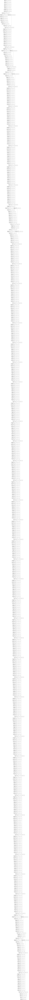

In [ ]:
visualizeModel(RESNET152V2, name)

In [ ]:
from datetime import datetime
start_time = datetime.now()
RESNET152V2_fit = RESNET152V2.fit(train_batches,epochs=30,validation_data=valid_batches, steps_per_epoch= len(train_batches), validation_steps= len(valid_batches))
end_time = datetime.now()

Epoch 1/30
805/805 [==============================] - 138s 166ms/step - loss: 3306.3354 - accuracy: 0.3685 - val_loss: 2382.2671 - val_accuracy: 0.4719
Epoch 2/30
805/805 [==============================] - 131s 162ms/step - loss: 2108.3564 - accuracy: 0.5272 - val_loss: 2105.4314 - val_accuracy: 0.5458
Epoch 3/30
805/805 [==============================] - 135s 167ms/step - loss: 2086.4512 - accuracy: 0.5860 - val_loss: 2052.7703 - val_accuracy: 0.5799
Epoch 4/30
805/805 [==============================] - 133s 165ms/step - loss: 1855.9373 - accuracy: 0.6323 - val_loss: 1495.9846 - val_accuracy: 0.6626
Epoch 5/30
805/805 [==============================] - 130s 161ms/step - loss: 1916.3801 - accuracy: 0.6517 - val_loss: 2090.1733 - val_accuracy: 0.6205
Epoch 6/30
805/805 [==============================] - 134s 166ms/step - loss: 1729.9845 - accuracy: 0.6866 - val_loss: 3496.8552 - val_accuracy: 0.5307
Epoch 7/30
805/805 [==============================] - 132s 164ms/step - loss: 1651.1570 

In [ ]:
import numpy as np
SaveHistory(RESNET152V2_fit, name)

In [ ]:
RESNET152V2_history = LoadHistory(name)

In [ ]:
print('Total Training Time: {}'.format(end_time - start_time))

print()

print("Last Trainig Accuracy = ")
print(RESNET152V2_history['accuracy'][-1])

print()

print("Last Validation Accuracy = ")
print(RESNET152V2_history['val_accuracy'][-1])

Total Training Time: 1:06:24.740630

Last Trainig Accuracy = 
0.8629270195960999

Last Testing Accuracy = 
0.7917119860649109


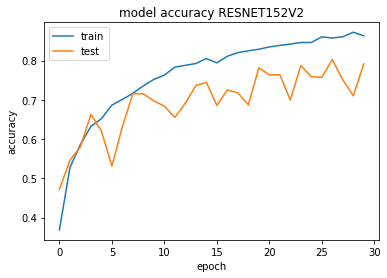

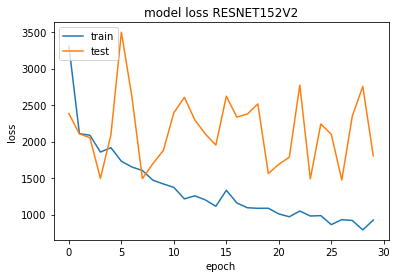

In [ ]:
accuracyLoss(RESNET152V2_history, name)

In [ ]:
SavingEntirety(RESNET152V2, name)

In [ ]:
loaded_RESNET152V2 = LoadingEntirety(name)

115/115 [==============================] - 157s 1s/step
Confusion matrix, without normalization
[[216   0   0   0   0   5   0   4   0   0   4   1   0   0   0   0]
 [  5 110   0   2   2  21   2   6   3   4   4  20   0  28  11  12]
 [  9   0 159   0   0  11   0   7   0   8  35   0   0   1   0   0]
 [  1   0   0 182  13   1   0   1   1   0   0   2  25   1   1   2]
 [  0   0   0   0 222   0   0   0   0   2   0   1   1   1   3   0]
 [  9   0   1   0   0 193   0   7   1   9   4   0   0   1   0   5]
 [  4   4   4   2   4   4  58   3   5   2  18   5  15  88   3  11]
 [ 14   0   0   0   0   6   0 194   0   1  10   1   0   4   0   0]
 [  1   1   1   2   1  11   0   6 178   2   2   2   5  10   0   8]
 [  1   0   0   0   0   6   0   0   0 222   0   1   0   0   0   0]
 [  3   0   1   0   0   2   0   7   1   1 213   0   0   2   0   0]
 [  4   0   0   1   1   9   0   1   1   3   0 176   0  25   2   7]
 [  0   0   0   7   4   1   0   0   1   0   1   2 211   0   1   2]
 [  2   0   0   0   0   1   0   3

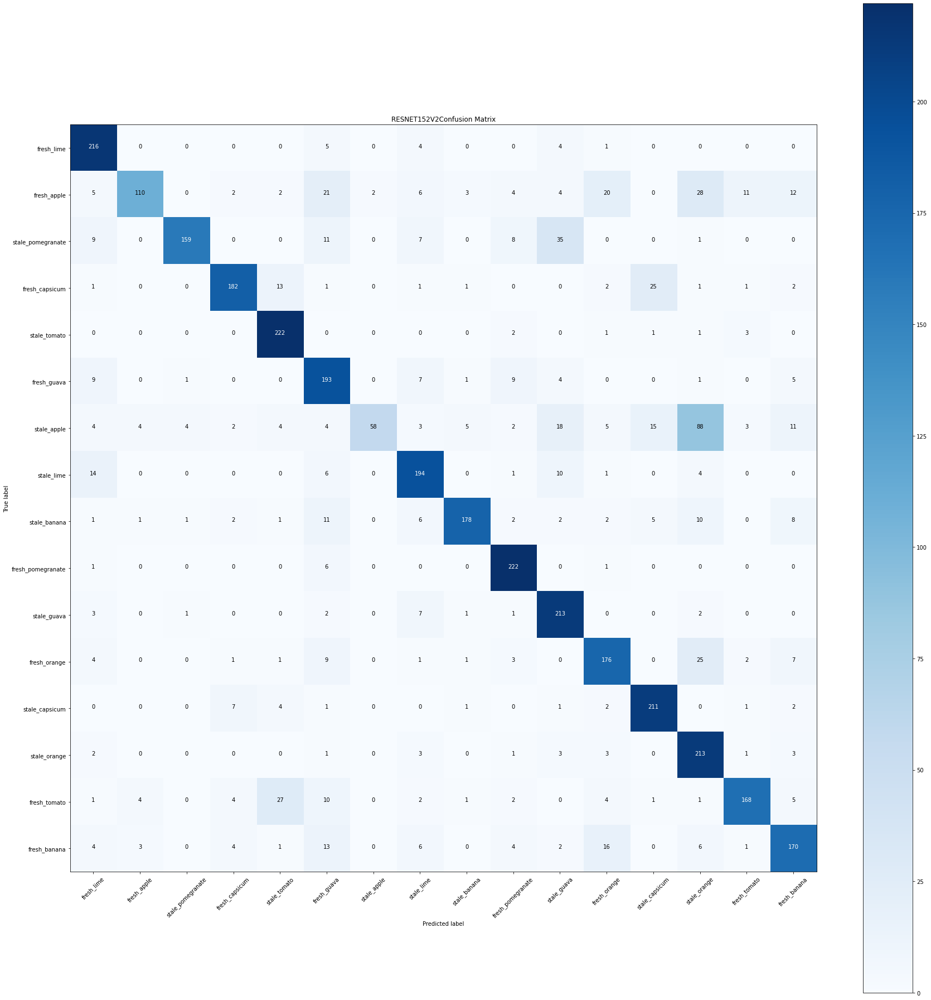

In [ ]:
ConfusionMatrix(loaded_RESNET152V2, name)

In [ ]:
ROC_AUC, Classification_Report = ROC_AUC_Classification_Report(loaded_RESNET152V2, name)

115/115 [==============================] - 173s 2s/step


In [ ]:
print(f"    ROC-AUC Score:      {ROC_AUC}\n")

    ROC-AUC Score:      0.8858509766855702



In [ ]:
print(Classification_Report)

115/115 [==============================] - 40s 324ms/step


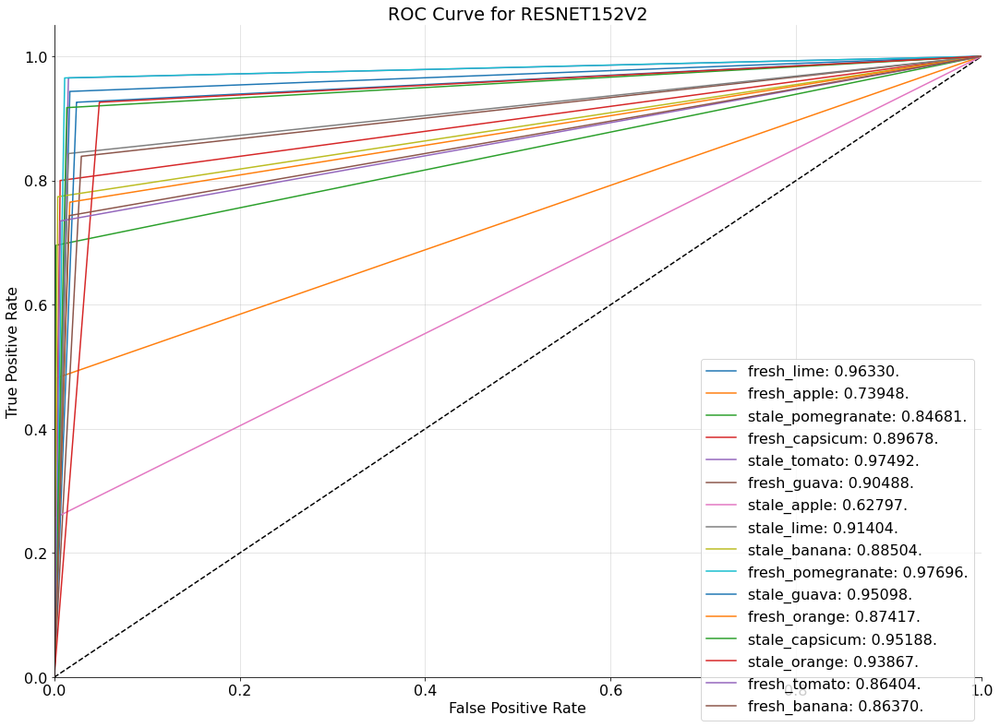

In [ ]:
plot_roc_curve(loaded_RESNET152V2, name)

In [ ]:
TestAccuracy = TestingAccuracy(loaded_RESNET152V2, name)
print(f"    Test Accuracy:      {TestAccuracy}\n")

115/115 [==============================] - 40s 332ms/step
    Test Accuracy:      0.7839673913043478



# **DenseNet201**

In [ ]:
from tensorflow.keras.layers import Input, Lambda, Dense, Flatten
from tensorflow.keras.models import Model
from tensorflow.keras.applications.densenet import DenseNet201
from tensorflow.keras.models import Sequential
import numpy as np
from glob import glob
import matplotlib.pyplot as plt

IMAGE_SIZE = [224, 224]

DenseNet201 = DenseNet201(input_shape=IMAGE_SIZE + [3], weights='imagenet', include_top=False)

for layer in DenseNet201.layers:
    layer.trainable = False

x = Flatten()(DenseNet201.output)

prediction = Dense(len(classe_labels), activation='softmax')(x)

DENSENET201 = Model(inputs=DenseNet201.input, outputs=prediction)

DENSENET201.compile(
  loss='categorical_crossentropy',
  optimizer='adam',
  metrics=['accuracy']
)

74850304/74836368 [==============================] - 0s 0us/step


In [ ]:
DENSENET201.summary()

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_6 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d (ZeroPadding2D)  (None, 230, 230, 3)  0          ['input_6[0][0]']                
                                                                                                  
 conv1/conv (Conv2D)            (None, 112, 112, 64  9408        ['zero_padding2d[0][0]']         
                                )                                                                 
                                                                                            

 n)                                                                                               
                                                                                                  
 conv2_block4_1_conv (Conv2D)   (None, 56, 56, 128)  20480       ['conv2_block4_0_relu[0][0]']    
                                                                                                  
 conv2_block4_1_bn (BatchNormal  (None, 56, 56, 128)  512        ['conv2_block4_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv2_block4_1_relu (Activatio  (None, 56, 56, 128)  0          ['conv2_block4_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv2_blo

 conv3_block2_0_relu (Activatio  (None, 28, 28, 160)  0          ['conv3_block2_0_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv3_block2_1_conv (Conv2D)   (None, 28, 28, 128)  20480       ['conv3_block2_0_relu[0][0]']    
                                                                                                  
 conv3_block2_1_bn (BatchNormal  (None, 28, 28, 128)  512        ['conv3_block2_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv3_block2_1_relu (Activatio  (None, 28, 28, 128)  0          ['conv3_block2_1_bn[0][0]']      
 n)                                                                                               
          

                                                                                                  
 conv3_block6_1_relu (Activatio  (None, 28, 28, 128)  0          ['conv3_block6_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv3_block6_2_conv (Conv2D)   (None, 28, 28, 32)   36864       ['conv3_block6_1_relu[0][0]']    
                                                                                                  
 conv3_block6_concat (Concatena  (None, 28, 28, 320)  0          ['conv3_block5_concat[0][0]',    
 te)                                                              'conv3_block6_2_conv[0][0]']    
                                                                                                  
 conv3_block7_0_bn (BatchNormal  (None, 28, 28, 320)  1280       ['conv3_block6_concat[0][0]']    
 ization) 

 ate)                                                             'conv3_block10_2_conv[0][0]']   
                                                                                                  
 conv3_block11_0_bn (BatchNorma  (None, 28, 28, 448)  1792       ['conv3_block10_concat[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv3_block11_0_relu (Activati  (None, 28, 28, 448)  0          ['conv3_block11_0_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv3_block11_1_conv (Conv2D)  (None, 28, 28, 128)  57344       ['conv3_block11_0_relu[0][0]']   
                                                                                                  
 conv3_blo

 conv4_block2_concat (Concatena  (None, 14, 14, 320)  0          ['conv4_block1_concat[0][0]',    
 te)                                                              'conv4_block2_2_conv[0][0]']    
                                                                                                  
 conv4_block3_0_bn (BatchNormal  (None, 14, 14, 320)  1280       ['conv4_block2_concat[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv4_block3_0_relu (Activatio  (None, 14, 14, 320)  0          ['conv4_block3_0_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv4_block3_1_conv (Conv2D)   (None, 14, 14, 128)  40960       ['conv4_block3_0_relu[0][0]']    
          

 n)                                                                                               
                                                                                                  
 conv4_block7_1_conv (Conv2D)   (None, 14, 14, 128)  57344       ['conv4_block7_0_relu[0][0]']    
                                                                                                  
 conv4_block7_1_bn (BatchNormal  (None, 14, 14, 128)  512        ['conv4_block7_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv4_block7_1_relu (Activatio  (None, 14, 14, 128)  0          ['conv4_block7_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv4_blo

 conv4_block11_1_relu (Activati  (None, 14, 14, 128)  0          ['conv4_block11_1_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv4_block11_2_conv (Conv2D)  (None, 14, 14, 32)   36864       ['conv4_block11_1_relu[0][0]']   
                                                                                                  
 conv4_block11_concat (Concaten  (None, 14, 14, 608)  0          ['conv4_block10_concat[0][0]',   
 ate)                                                             'conv4_block11_2_conv[0][0]']   
                                                                                                  
 conv4_block12_0_bn (BatchNorma  (None, 14, 14, 608)  2432       ['conv4_block11_concat[0][0]']   
 lization)                                                                                        
          

                                                                                                  
 conv4_block16_0_bn (BatchNorma  (None, 14, 14, 736)  2944       ['conv4_block15_concat[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv4_block16_0_relu (Activati  (None, 14, 14, 736)  0          ['conv4_block16_0_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv4_block16_1_conv (Conv2D)  (None, 14, 14, 128)  94208       ['conv4_block16_0_relu[0][0]']   
                                                                                                  
 conv4_block16_1_bn (BatchNorma  (None, 14, 14, 128)  512        ['conv4_block16_1_conv[0][0]']   
 lization)

 conv4_block20_1_conv (Conv2D)  (None, 14, 14, 128)  110592      ['conv4_block20_0_relu[0][0]']   
                                                                                                  
 conv4_block20_1_bn (BatchNorma  (None, 14, 14, 128)  512        ['conv4_block20_1_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv4_block20_1_relu (Activati  (None, 14, 14, 128)  0          ['conv4_block20_1_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv4_block20_2_conv (Conv2D)  (None, 14, 14, 32)   36864       ['conv4_block20_1_relu[0][0]']   
                                                                                                  
 conv4_blo

                                                                                                  
 conv4_block24_2_conv (Conv2D)  (None, 14, 14, 32)   36864       ['conv4_block24_1_relu[0][0]']   
                                                                                                  
 conv4_block24_concat (Concaten  (None, 14, 14, 1024  0          ['conv4_block23_concat[0][0]',   
 ate)                           )                                 'conv4_block24_2_conv[0][0]']   
                                                                                                  
 conv4_block25_0_bn (BatchNorma  (None, 14, 14, 1024  4096       ['conv4_block24_concat[0][0]']   
 lization)                      )                                                                 
                                                                                                  
 conv4_block25_0_relu (Activati  (None, 14, 14, 1024  0          ['conv4_block25_0_bn[0][0]']     
 on)      

 lization)                      )                                                                 
                                                                                                  
 conv4_block29_0_relu (Activati  (None, 14, 14, 1152  0          ['conv4_block29_0_bn[0][0]']     
 on)                            )                                                                 
                                                                                                  
 conv4_block29_1_conv (Conv2D)  (None, 14, 14, 128)  147456      ['conv4_block29_0_relu[0][0]']   
                                                                                                  
 conv4_block29_1_bn (BatchNorma  (None, 14, 14, 128)  512        ['conv4_block29_1_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv4_blo

 conv4_block33_1_bn (BatchNorma  (None, 14, 14, 128)  512        ['conv4_block33_1_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv4_block33_1_relu (Activati  (None, 14, 14, 128)  0          ['conv4_block33_1_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv4_block33_2_conv (Conv2D)  (None, 14, 14, 32)   36864       ['conv4_block33_1_relu[0][0]']   
                                                                                                  
 conv4_block33_concat (Concaten  (None, 14, 14, 1312  0          ['conv4_block32_concat[0][0]',   
 ate)                           )                                 'conv4_block33_2_conv[0][0]']   
          

                                                                                                  
 conv4_block37_concat (Concaten  (None, 14, 14, 1440  0          ['conv4_block36_concat[0][0]',   
 ate)                           )                                 'conv4_block37_2_conv[0][0]']   
                                                                                                  
 conv4_block38_0_bn (BatchNorma  (None, 14, 14, 1440  5760       ['conv4_block37_concat[0][0]']   
 lization)                      )                                                                 
                                                                                                  
 conv4_block38_0_relu (Activati  (None, 14, 14, 1440  0          ['conv4_block38_0_bn[0][0]']     
 on)                            )                                                                 
                                                                                                  
 conv4_blo

 conv4_block42_0_relu (Activati  (None, 14, 14, 1568  0          ['conv4_block42_0_bn[0][0]']     
 on)                            )                                                                 
                                                                                                  
 conv4_block42_1_conv (Conv2D)  (None, 14, 14, 128)  200704      ['conv4_block42_0_relu[0][0]']   
                                                                                                  
 conv4_block42_1_bn (BatchNorma  (None, 14, 14, 128)  512        ['conv4_block42_1_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv4_block42_1_relu (Activati  (None, 14, 14, 128)  0          ['conv4_block42_1_bn[0][0]']     
 on)                                                                                              
          

                                                                                                  
 conv4_block46_1_relu (Activati  (None, 14, 14, 128)  0          ['conv4_block46_1_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv4_block46_2_conv (Conv2D)  (None, 14, 14, 32)   36864       ['conv4_block46_1_relu[0][0]']   
                                                                                                  
 conv4_block46_concat (Concaten  (None, 14, 14, 1728  0          ['conv4_block45_concat[0][0]',   
 ate)                           )                                 'conv4_block46_2_conv[0][0]']   
                                                                                                  
 conv4_block47_0_bn (BatchNorma  (None, 14, 14, 1728  6912       ['conv4_block46_concat[0][0]']   
 lization)

                                                                                                  
 conv5_block2_1_bn (BatchNormal  (None, 7, 7, 128)   512         ['conv5_block2_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv5_block2_1_relu (Activatio  (None, 7, 7, 128)   0           ['conv5_block2_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv5_block2_2_conv (Conv2D)   (None, 7, 7, 32)     36864       ['conv5_block2_1_relu[0][0]']    
                                                                                                  
 conv5_block2_concat (Concatena  (None, 7, 7, 960)   0           ['conv5_block1_concat[0][0]',    
 te)      

 conv5_block6_2_conv (Conv2D)   (None, 7, 7, 32)     36864       ['conv5_block6_1_relu[0][0]']    
                                                                                                  
 conv5_block6_concat (Concatena  (None, 7, 7, 1088)  0           ['conv5_block5_concat[0][0]',    
 te)                                                              'conv5_block6_2_conv[0][0]']    
                                                                                                  
 conv5_block7_0_bn (BatchNormal  (None, 7, 7, 1088)  4352        ['conv5_block6_concat[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv5_block7_0_relu (Activatio  (None, 7, 7, 1088)  0           ['conv5_block7_0_bn[0][0]']      
 n)                                                                                               
          

                                                                                                  
 conv5_block11_0_relu (Activati  (None, 7, 7, 1216)  0           ['conv5_block11_0_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv5_block11_1_conv (Conv2D)  (None, 7, 7, 128)    155648      ['conv5_block11_0_relu[0][0]']   
                                                                                                  
 conv5_block11_1_bn (BatchNorma  (None, 7, 7, 128)   512         ['conv5_block11_1_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv5_block11_1_relu (Activati  (None, 7, 7, 128)   0           ['conv5_block11_1_bn[0][0]']     
 on)      

 lization)                                                                                        
                                                                                                  
 conv5_block15_1_relu (Activati  (None, 7, 7, 128)   0           ['conv5_block15_1_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv5_block15_2_conv (Conv2D)  (None, 7, 7, 32)     36864       ['conv5_block15_1_relu[0][0]']   
                                                                                                  
 conv5_block15_concat (Concaten  (None, 7, 7, 1376)  0           ['conv5_block14_concat[0][0]',   
 ate)                                                             'conv5_block15_2_conv[0][0]']   
                                                                                                  
 conv5_blo

 conv5_block19_concat (Concaten  (None, 7, 7, 1504)  0           ['conv5_block18_concat[0][0]',   
 ate)                                                             'conv5_block19_2_conv[0][0]']   
                                                                                                  
 conv5_block20_0_bn (BatchNorma  (None, 7, 7, 1504)  6016        ['conv5_block19_concat[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv5_block20_0_relu (Activati  (None, 7, 7, 1504)  0           ['conv5_block20_0_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv5_block20_1_conv (Conv2D)  (None, 7, 7, 128)    192512      ['conv5_block20_0_relu[0][0]']   
          

 on)                                                                                              
                                                                                                  
 conv5_block24_1_conv (Conv2D)  (None, 7, 7, 128)    208896      ['conv5_block24_0_relu[0][0]']   
                                                                                                  
 conv5_block24_1_bn (BatchNorma  (None, 7, 7, 128)   512         ['conv5_block24_1_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv5_block24_1_relu (Activati  (None, 7, 7, 128)   0           ['conv5_block24_1_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv5_blo

 conv5_block28_1_relu (Activati  (None, 7, 7, 128)   0           ['conv5_block28_1_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv5_block28_2_conv (Conv2D)  (None, 7, 7, 32)     36864       ['conv5_block28_1_relu[0][0]']   
                                                                                                  
 conv5_block28_concat (Concaten  (None, 7, 7, 1792)  0           ['conv5_block27_concat[0][0]',   
 ate)                                                             'conv5_block28_2_conv[0][0]']   
                                                                                                  
 conv5_block29_0_bn (BatchNorma  (None, 7, 7, 1792)  7168        ['conv5_block28_concat[0][0]']   
 lization)                                                                                        
          

                                                                                                  
 bn (BatchNormalization)        (None, 7, 7, 1920)   7680        ['conv5_block32_concat[0][0]']   
                                                                                                  
 relu (Activation)              (None, 7, 7, 1920)   0           ['bn[0][0]']                     
                                                                                                  
 flatten_5 (Flatten)            (None, 94080)        0           ['relu[0][0]']                   
                                                                                                  
 dense_4 (Dense)                (None, 16)           1505296     ['flatten_5[0][0]']              
                                                                                                  
Total params: 19,827,280
Trainable params: 1,505,296
Non-trainable params: 18,321,984
_______________________

In [ ]:
name = "DENSENET201"

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.32712 to fit



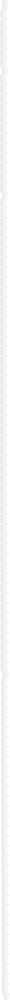

In [ ]:
visualizeModel(DENSENET201, name)

In [ ]:
from datetime import datetime
start_time = datetime.now()
DENSENET201_fit = DENSENET201.fit(train_batches,epochs=30,validation_data=valid_batches, steps_per_epoch= len(train_batches), validation_steps= len(valid_batches))
end_time = datetime.now()

Epoch 1/30
805/805 [==============================] - 140s 167ms/step - loss: 17.5905 - accuracy: 0.7803 - val_loss: 16.6452 - val_accuracy: 0.8317
Epoch 2/30
805/805 [==============================] - 132s 164ms/step - loss: 9.6590 - accuracy: 0.8973 - val_loss: 14.7020 - val_accuracy: 0.8697
Epoch 3/30
805/805 [==============================] - 132s 164ms/step - loss: 7.3721 - accuracy: 0.9263 - val_loss: 8.6074 - val_accuracy: 0.9103
Epoch 4/30
805/805 [==============================] - 132s 164ms/step - loss: 6.3503 - accuracy: 0.9421 - val_loss: 10.7357 - val_accuracy: 0.9202
Epoch 5/30
805/805 [==============================] - 132s 164ms/step - loss: 6.1792 - accuracy: 0.9470 - val_loss: 21.5406 - val_accuracy: 0.8867
Epoch 6/30
805/805 [==============================] - 132s 164ms/step - loss: 5.2000 - accuracy: 0.9556 - val_loss: 11.0960 - val_accuracy: 0.9302
Epoch 7/30
805/805 [==============================] - 133s 165ms/step - loss: 5.4620 - accuracy: 0.9588 - val_loss: 11

In [ ]:
import numpy as np
SaveHistory(DENSENET201_fit, name)

In [ ]:
DENSENET201_history = LoadHistory(name)

In [ ]:
print('Total Training Time: {}'.format(end_time - start_time))

print()

print("Last Trainig Accuracy = ")
print(DENSENET201_history['accuracy'][-1])

print()

print("Last Validation Accuracy = ")
print(DENSENET201_history['val_accuracy'][-1])

Total Training Time: 1:07:03.817235

Last Trainig Accuracy = 
0.989673912525177

Last Testing Accuracy = 
0.959510862827301


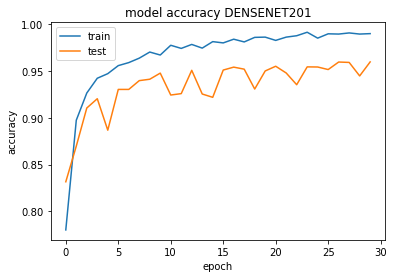

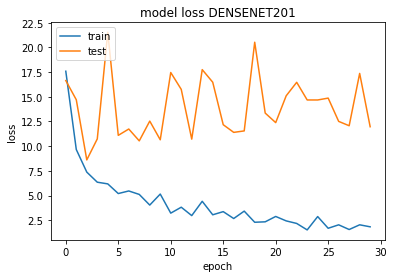

In [ ]:
accuracyLoss(DENSENET201_history, name)

In [ ]:
SavingEntirety(DENSENET201, name)

In [ ]:
loaded_DENSENET201 = LoadingEntirety(name)

115/115 [==============================] - 138s 1s/step
Confusion matrix, without normalization
[[229   0   0   0   0   0   0   0   0   0   1   0   0   0   0   0]
 [  0 213   0   2   0   1   1   2   1   1   1   1   0   1   6   0]
 [  0   3 225   0   0   0   1   0   0   1   0   0   0   0   0   0]
 [  0   0   0 229   0   0   0   0   0   0   0   0   0   0   1   0]
 [  0   0   0   2 223   0   0   0   0   0   0   1   1   0   3   0]
 [  3   4   0   0   0 218   0   1   0   0   3   0   0   0   0   1]
 [  0  23   2   0   0   0 193   0   0   2   0   2   1   3   0   4]
 [  1   0   0   0   0   0   0 226   0   0   3   0   0   0   0   0]
 [  0   1   0   2   0   0   3   1 219   0   0   2   0   0   1   1]
 [  0   0   0   0   0   0   0   0   0 230   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0   1   0 229   0   0   0   0   0]
 [  1   4   0   1   0   1   3   0   0   1   0 219   0   0   0   0]
 [  0   0   0   8   0   0   0   0   0   0   0   0 222   0   0   0]
 [  0   4   0   0   0   0  10   0

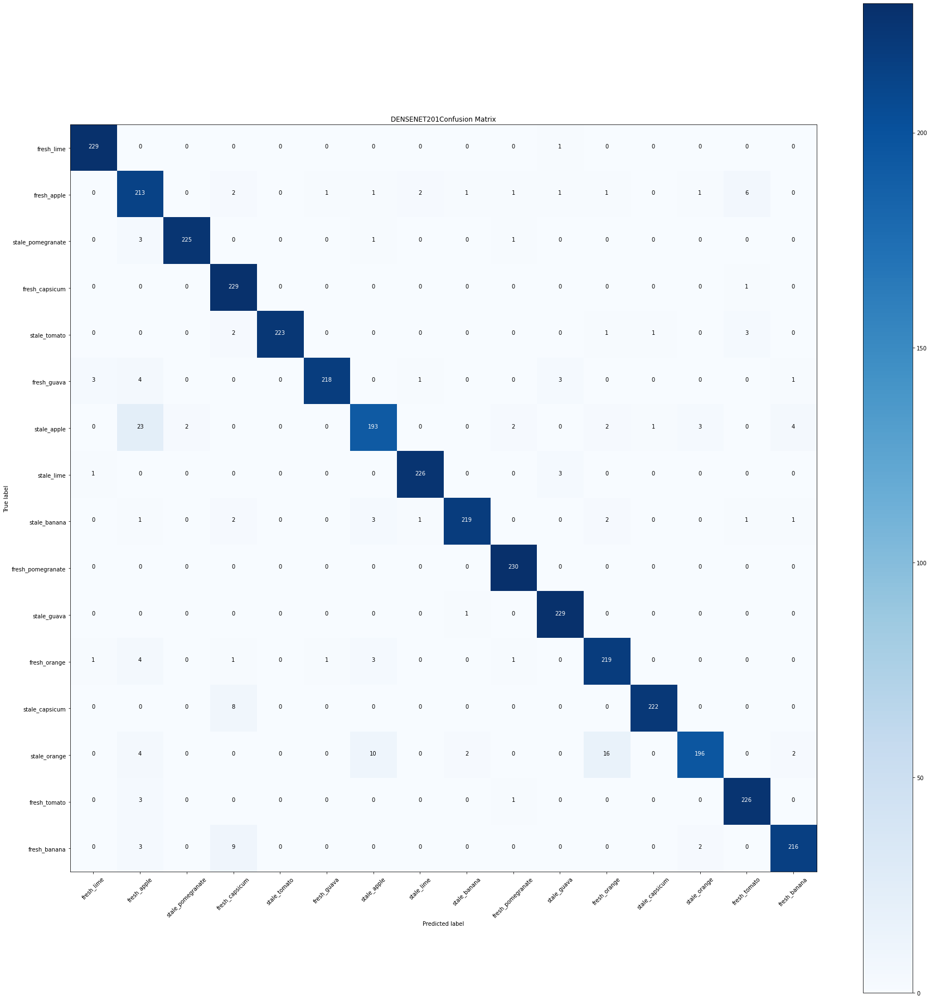

In [ ]:
ConfusionMatrix(loaded_DENSENET201, name)

In [ ]:
ROC_AUC, Classification_Report = ROC_AUC_Classification_Report(loaded_DENSENET201, name)

115/115 [==============================] - 133s 1s/step


In [ ]:
print(f"    ROC-AUC Score:      {ROC_AUC}\n")

    ROC-AUC Score:      0.9808330970384372



In [ ]:
print(Classification_Report)

115/115 [==============================] - 40s 306ms/step


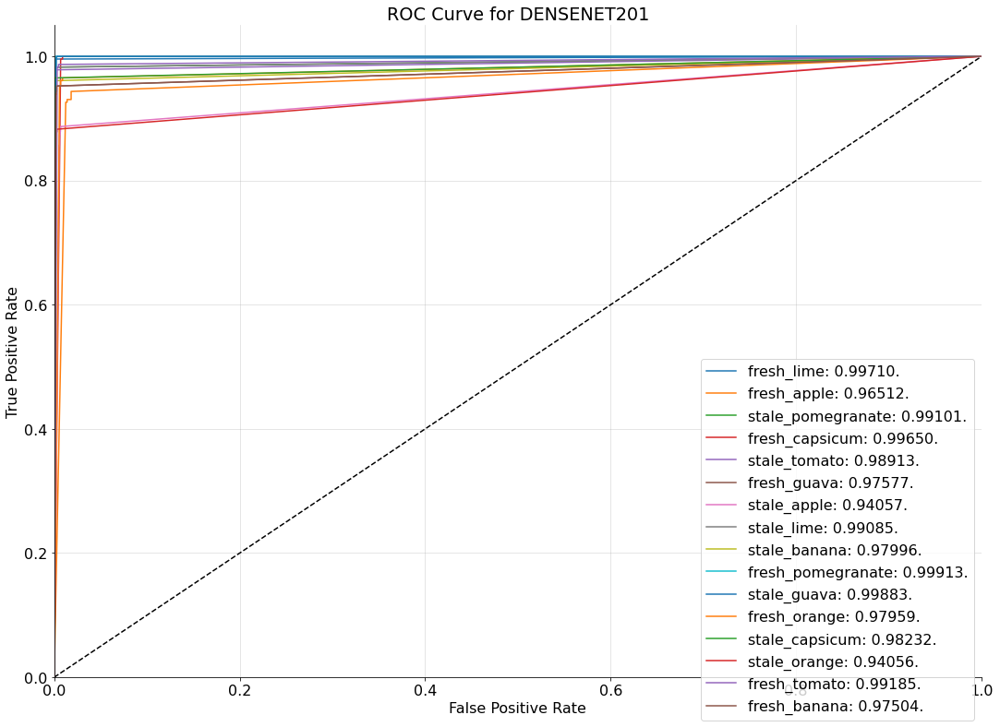

In [ ]:
plot_roc_curve(loaded_DENSENET201, name)

In [ ]:
TestAccuracy = TestingAccuracy(loaded_DENSENET201, name)
print(f"    Test Accuracy:      {TestAccuracy}\n")

115/115 [==============================] - 38s 305ms/step
    Test Accuracy:      0.9546195652173913



# **MobileNetV2**

In [ ]:
from tensorflow.keras.layers import Input, Lambda, Dense, Flatten
from tensorflow.keras.models import Model
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.models import Sequential
import numpy as np
from glob import glob
import matplotlib.pyplot as plt

IMAGE_SIZE = [224, 224]

MobileNetV2 = MobileNetV2(input_shape=IMAGE_SIZE + [3], weights='imagenet', include_top=False)

for layer in MobileNetV2.layers:
    layer.trainable = False

x = Flatten()(MobileNetV2.output)

prediction = Dense(len(classe_labels), activation='softmax')(x)

MOBILENETV2 = Model(inputs=MobileNetV2.input, outputs=prediction)

MOBILENETV2.compile(
  loss='categorical_crossentropy',
  optimizer='adam',
  metrics=['accuracy']
)

9420800/9406464 [==============================] - 0s 0us/step


In [ ]:
MOBILENETV2.summary()

Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 112, 112, 32  864         ['input_7[0][0]']                
                                )                                                                 
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 112, 112, 32  128         ['Conv1[0][0]']                  
                                )                                                           

 block_3_expand_relu (ReLU)     (None, 56, 56, 144)  0           ['block_3_expand_BN[0][0]']      
                                                                                                  
 block_3_pad (ZeroPadding2D)    (None, 57, 57, 144)  0           ['block_3_expand_relu[0][0]']    
                                                                                                  
 block_3_depthwise (DepthwiseCo  (None, 28, 28, 144)  1296       ['block_3_pad[0][0]']            
 nv2D)                                                                                            
                                                                                                  
 block_3_depthwise_BN (BatchNor  (None, 28, 28, 144)  576        ['block_3_depthwise[0][0]']      
 malization)                                                                                      
                                                                                                  
 block_3_d

 lization)                                                                                        
                                                                                                  
 block_7_expand (Conv2D)        (None, 14, 14, 384)  24576       ['block_6_project_BN[0][0]']     
                                                                                                  
 block_7_expand_BN (BatchNormal  (None, 14, 14, 384)  1536       ['block_7_expand[0][0]']         
 ization)                                                                                         
                                                                                                  
 block_7_expand_relu (ReLU)     (None, 14, 14, 384)  0           ['block_7_expand_BN[0][0]']      
                                                                                                  
 block_7_depthwise (DepthwiseCo  (None, 14, 14, 384)  3456       ['block_7_expand_relu[0][0]']    
 nv2D)    

                                                                                                  
 block_10_depthwise_relu (ReLU)  (None, 14, 14, 384)  0          ['block_10_depthwise_BN[0][0]']  
                                                                                                  
 block_10_project (Conv2D)      (None, 14, 14, 96)   36864       ['block_10_depthwise_relu[0][0]']
                                                                                                  
 block_10_project_BN (BatchNorm  (None, 14, 14, 96)  384         ['block_10_project[0][0]']       
 alization)                                                                                       
                                                                                                  
 block_11_expand (Conv2D)       (None, 14, 14, 576)  55296       ['block_10_project_BN[0][0]']    
                                                                                                  
 block_11_

 block_14_depthwise (DepthwiseC  (None, 7, 7, 960)   8640        ['block_14_expand_relu[0][0]']   
 onv2D)                                                                                           
                                                                                                  
 block_14_depthwise_BN (BatchNo  (None, 7, 7, 960)   3840        ['block_14_depthwise[0][0]']     
 rmalization)                                                                                     
                                                                                                  
 block_14_depthwise_relu (ReLU)  (None, 7, 7, 960)   0           ['block_14_depthwise_BN[0][0]']  
                                                                                                  
 block_14_project (Conv2D)      (None, 7, 7, 160)    153600      ['block_14_depthwise_relu[0][0]']
                                                                                                  
 block_14_

In [ ]:
name = "MOBILENETV2"

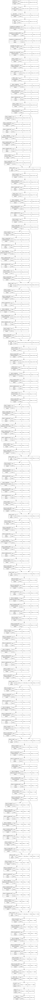

In [ ]:
visualizeModel(MOBILENETV2, name)

In [ ]:
from datetime import datetime
start_time = datetime.now()
MOBILENETV2_fit = MOBILENETV2.fit(train_batches,epochs=30,validation_data=valid_batches, steps_per_epoch= len(train_batches), validation_steps= len(valid_batches))
end_time = datetime.now()

Epoch 1/30
805/805 [==============================] - 133s 163ms/step - loss: 3.1730 - accuracy: 0.7996 - val_loss: 1.9806 - val_accuracy: 0.8799
Epoch 2/30
805/805 [==============================] - 132s 163ms/step - loss: 0.9733 - accuracy: 0.9370 - val_loss: 3.4986 - val_accuracy: 0.8614
Epoch 3/30
805/805 [==============================] - 131s 163ms/step - loss: 0.7912 - accuracy: 0.9539 - val_loss: 2.2158 - val_accuracy: 0.9114
Epoch 4/30
805/805 [==============================] - 132s 164ms/step - loss: 0.6879 - accuracy: 0.9636 - val_loss: 2.9739 - val_accuracy: 0.9043
Epoch 5/30
805/805 [==============================] - 132s 164ms/step - loss: 0.5988 - accuracy: 0.9705 - val_loss: 3.9925 - val_accuracy: 0.8906
Epoch 6/30
805/805 [==============================] - 133s 166ms/step - loss: 0.6202 - accuracy: 0.9710 - val_loss: 3.1603 - val_accuracy: 0.9197
Epoch 7/30
805/805 [==============================] - 131s 163ms/step - loss: 0.4499 - accuracy: 0.9796 - val_loss: 3.8855 -

In [ ]:
import numpy as np
SaveHistory(MOBILENETV2_fit, name)

In [ ]:
MOBILENETV2_history = LoadHistory(name)

In [ ]:
print('Total Training Time: {}'.format(end_time - start_time))

print()

print("Last Trainig Accuracy = ")
print(MOBILENETV2_history['accuracy'][-1])

print()

print("Last Validation Accuracy = ")
print(MOBILENETV2_history['val_accuracy'][-1])

Total Training Time: 1:06:09.297637

Last Trainig Accuracy = 
0.9946816563606262

Last Testing Accuracy = 
0.9275815486907959


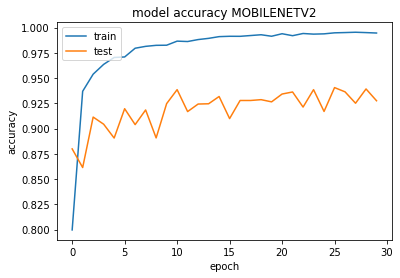

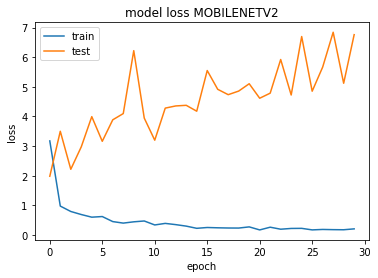

In [ ]:
accuracyLoss(MOBILENETV2_history, name)

In [ ]:
SavingEntirety(MOBILENETV2, name)

In [ ]:
loaded_MOBILENETV2 = LoadingEntirety(name)

115/115 [==============================] - 45s 381ms/step
Confusion matrix, without normalization
[[224   0   0   0   0   2   0   3   0   0   0   0   0   1   0   0]
 [  1 206   2   2   0   0   6   0   0   0   0   4   0   7   1   1]
 [  0   1 228   0   0   0   0   0   0   0   0   0   0   0   0   1]
 [  0   6   0 218   0   1   1   0   1   0   0   0   2   0   0   1]
 [  0   1   0   0 223   0   0   0   0   0   0   0   2   2   2   0]
 [  7  11   2   0   0 199   3   3   0   0   0   1   0   3   0   1]
 [  0  10   0   0   0   0 214   0   1   0   0   0   1   4   0   0]
 [  1   2   0   0   0   1   2 219   0   0   3   0   1   1   0   0]
 [  0   0   0   0   0   0   1   0 226   0   0   0   0   0   0   3]
 [  0   4   2   0   0   0   0   0   1 223   0   0   0   0   0   0]
 [  0   4   4   0   0   1   3   3   0   0 213   0   0   2   0   0]
 [  4  28   0   1   1   0   5   0   0   1   0 173   0  15   1   1]
 [  0   0   0   3   1   0   0   0   0   0   0   0 226   0   0   0]
 [  0   2   0   0   0   0   0  

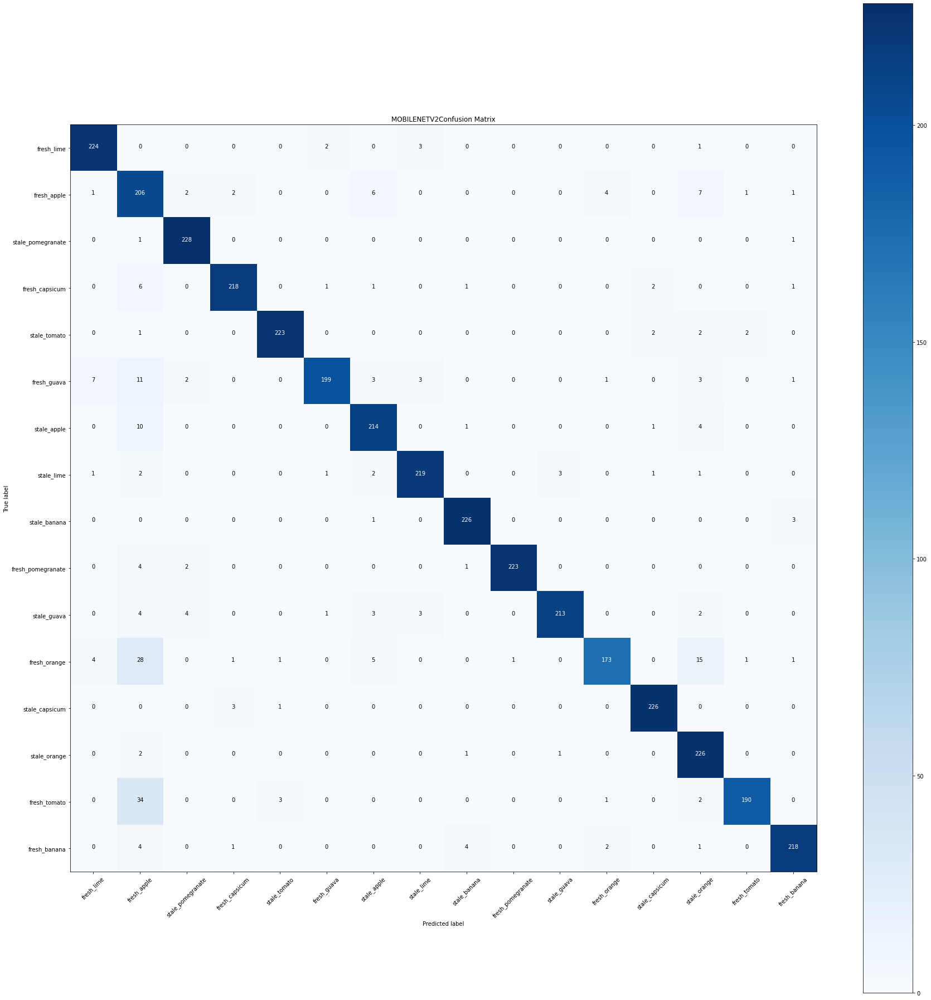

In [ ]:
ConfusionMatrix(loaded_MOBILENETV2, name)

In [ ]:
ROC_AUC, Classification_Report = ROC_AUC_Classification_Report(loaded_MOBILENETV2, name)

115/115 [==============================] - 42s 368ms/step


In [ ]:
print(f"    ROC-AUC Score:      {ROC_AUC}\n")

    ROC-AUC Score:      0.9814354914933837



In [ ]:
print(Classification_Report)

                   precision    recall  f1-score   support

       fresh_lime       0.95      0.97      0.96       230
      fresh_apple       0.66      0.90      0.76       230
stale_pomegranate       0.96      0.99      0.97       230
   fresh_capsicum       0.97      0.95      0.96       230
     stale_tomato       0.98      0.97      0.97       230
      fresh_guava       0.98      0.87      0.92       230
      stale_apple       0.91      0.93      0.92       230
       stale_lime       0.96      0.95      0.96       230
     stale_banana       0.97      0.98      0.97       230
fresh_pomegranate       1.00      0.97      0.98       230
      stale_guava       0.98      0.93      0.95       230
     fresh_orange       0.96      0.75      0.84       230
   stale_capsicum       0.97      0.98      0.98       230
     stale_orange       0.86      0.98      0.91       230
     fresh_tomato       0.98      0.83      0.90       230
     fresh_banana       0.96      0.95      0.96       

115/115 [==============================] - 34s 284ms/step


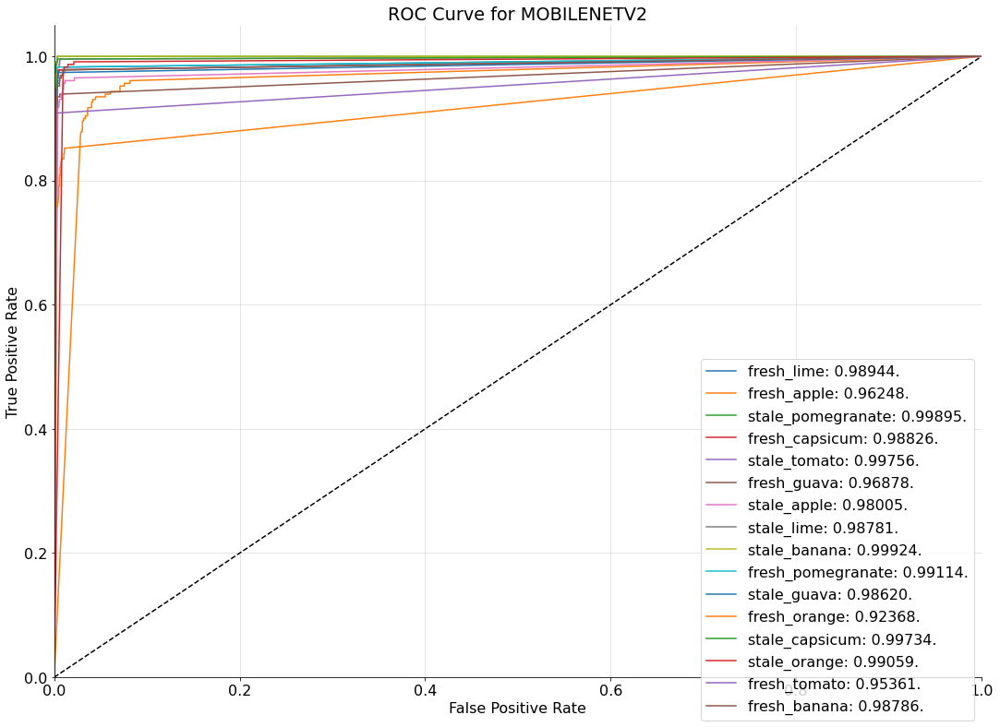

In [ ]:
plot_roc_curve(loaded_MOBILENETV2, name)

In [ ]:
TestAccuracy = TestingAccuracy(loaded_MOBILENETV2, name)
print(f"    Test Accuracy:      {TestAccuracy}\n")

115/115 [==============================] - 34s 293ms/step
    Test Accuracy:      0.9309782608695653



# **FreshDNN Version(.Custom Model)**

In [ ]:
import tensorflow as tf
freshDNN=tf.keras.Sequential()

freshDNN.add(tf.keras.layers.Conv2D(filters=32,padding='same',strides=2,kernel_size=3,activation='relu',input_shape=(224,224,3)))
freshDNN.add(tf.keras.layers.BatchNormalization())
freshDNN.add(tf.keras.layers.MaxPool2D(pool_size=2,strides=2))

freshDNN.add(tf.keras.layers.Conv2D(filters=64,padding='same',strides=2,kernel_size=3,activation='relu'))
freshDNN.add(tf.keras.layers.BatchNormalization())
freshDNN.add(tf.keras.layers.MaxPool2D(pool_size=2,strides=2))

freshDNN.add(tf.keras.layers.Conv2D(filters=128,padding='same',strides=2,kernel_size=3,activation='relu'))
freshDNN.add(tf.keras.layers.BatchNormalization())
freshDNN.add(tf.keras.layers.MaxPool2D(pool_size=2,strides=2))

freshDNN.add(tf.keras.layers.Conv2D(filters=256,padding='same',strides=2,kernel_size=3,activation='relu'))
freshDNN.add(tf.keras.layers.BatchNormalization())
freshDNN.add(tf.keras.layers.MaxPool2D(pool_size=2))

freshDNN.add(tf.keras.layers.Flatten())
freshDNN.add(tf.keras.layers.Dropout(0.3))
freshDNN.add(tf.keras.layers.Dense(16,activation='softmax'))

freshDNN.compile(optimizer=tf.keras.optimizers.Adam(),loss='categorical_crossentropy',metrics=['accuracy'])

In [ ]:
freshDNN.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 112, 112, 32)      896       
                                                                 
 batch_normalization (BatchN  (None, 112, 112, 32)     128       
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 56, 56, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 28, 28, 64)        18496     
                                                                 
 batch_normalization_1 (Batc  (None, 28, 28, 64)       256       
 hNormalization)                                                 
                                                        

In [ ]:
name = "FreshDNN (Custom Model)"

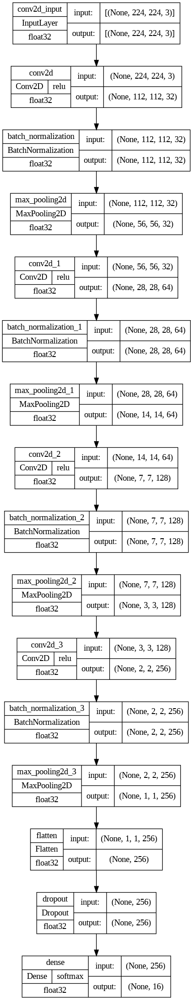

In [ ]:
visualizeModel(freshDNN, name)

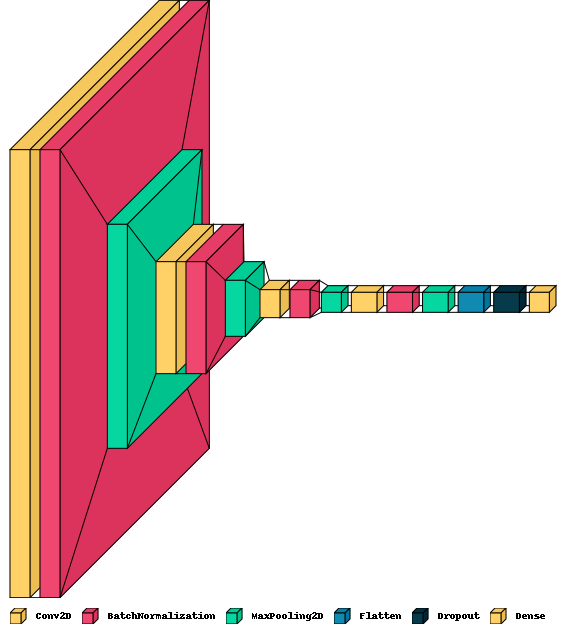

In [ ]:
import visualkeras
visualkeras.layered_view(freshDNN, legend=True)

In [ ]:
from datetime import datetime
start_time = datetime.now()

freshDNN_fit = freshDNN.fit(train_batches,epochs=30,validation_data=valid_batches, steps_per_epoch= len(train_batches), validation_steps= len(valid_batches))

end_time = datetime.now()

Epoch 1/30
805/805 [==============================] - 131s 161ms/step - loss: 0.7699 - accuracy: 0.7677 - val_loss: 0.3345 - val_accuracy: 0.8925
Epoch 2/30
805/805 [==============================] - 129s 160ms/step - loss: 0.3128 - accuracy: 0.8982 - val_loss: 0.3118 - val_accuracy: 0.8995
Epoch 3/30
805/805 [==============================] - 133s 166ms/step - loss: 0.2171 - accuracy: 0.9294 - val_loss: 0.1821 - val_accuracy: 0.9414
Epoch 4/30
805/805 [==============================] - 132s 164ms/step - loss: 0.1557 - accuracy: 0.9471 - val_loss: 0.1548 - val_accuracy: 0.9507
Epoch 5/30
805/805 [==============================] - 131s 163ms/step - loss: 0.1366 - accuracy: 0.9552 - val_loss: 0.2373 - val_accuracy: 0.9293
Epoch 6/30
805/805 [==============================] - 131s 163ms/step - loss: 0.1110 - accuracy: 0.9635 - val_loss: 0.1577 - val_accuracy: 0.9518
Epoch 7/30
805/805 [==============================] - 133s 165ms/step - loss: 0.0934 - accuracy: 0.9694 - val_loss: 0.1576 -

In [ ]:
import numpy as np
SaveHistory(freshDNN_fit, name)

In [ ]:
freshDNN_history = LoadHistory(name)

In [ ]:
print('Total Training Time: {}'.format(end_time - start_time))

print()

print("Last Trainig Accuracy = ")
print(freshDNN_history['accuracy'][-1])

print()

print("Last Validation Accuracy = ")
print(freshDNN_history['val_accuracy'][-1])

Total Training Time: 1:05:49.154692

Last Trainig Accuracy = 
0.9932453632354736

Last Testing Accuracy = 
0.977989137172699


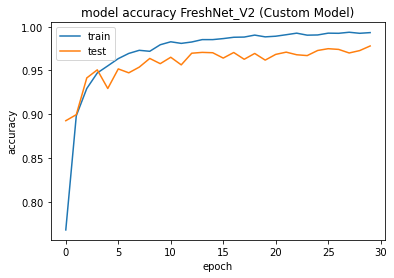

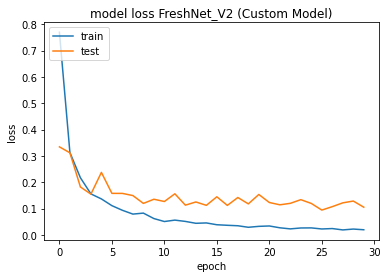

In [ ]:
accuracyLoss(freshDNN_history, name)

In [ ]:
SavingEntirety(freshDNN, name)

In [ ]:
loaded_freshDNN = LoadingEntirety(name)

115/115 [==============================] - 37s 325ms/step
Confusion matrix, without normalization
[[227   0   0   0   0   2   0   1   0   0   0   0   0   0   0   0]
 [  0 206   3   1   1   2   8   1   3   0   0   2   0   0   2   1]
 [  0   0 230   0   0   0   0   0   0   0   0   0   0   0   0   0]
 [  0   1   0 225   0   2   0   0   0   0   0   1   0   0   1   0]
 [  0   0   0   0 230   0   0   0   0   0   0   0   0   0   0   0]
 [  1   1   0   0   0 222   0   5   1   0   0   0   0   0   0   0]
 [  0   0   4   0   0   0 224   0   0   0   0   0   0   1   1   0]
 [  1   0   0   0   0   0   0 227   0   0   2   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0 230   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0   0 230   0   0   0   0   0   0]
 [  0   0   0   0   0   1   0   1   2   0 226   0   0   0   0   0]
 [  3   0   0   0   0   0   1   0   0   0   0 224   1   0   0   1]
 [  0   0   0   0   0   0   0   0   0   0   0   0 230   0   0   0]
 [  0   0   0   0   0   0   1  

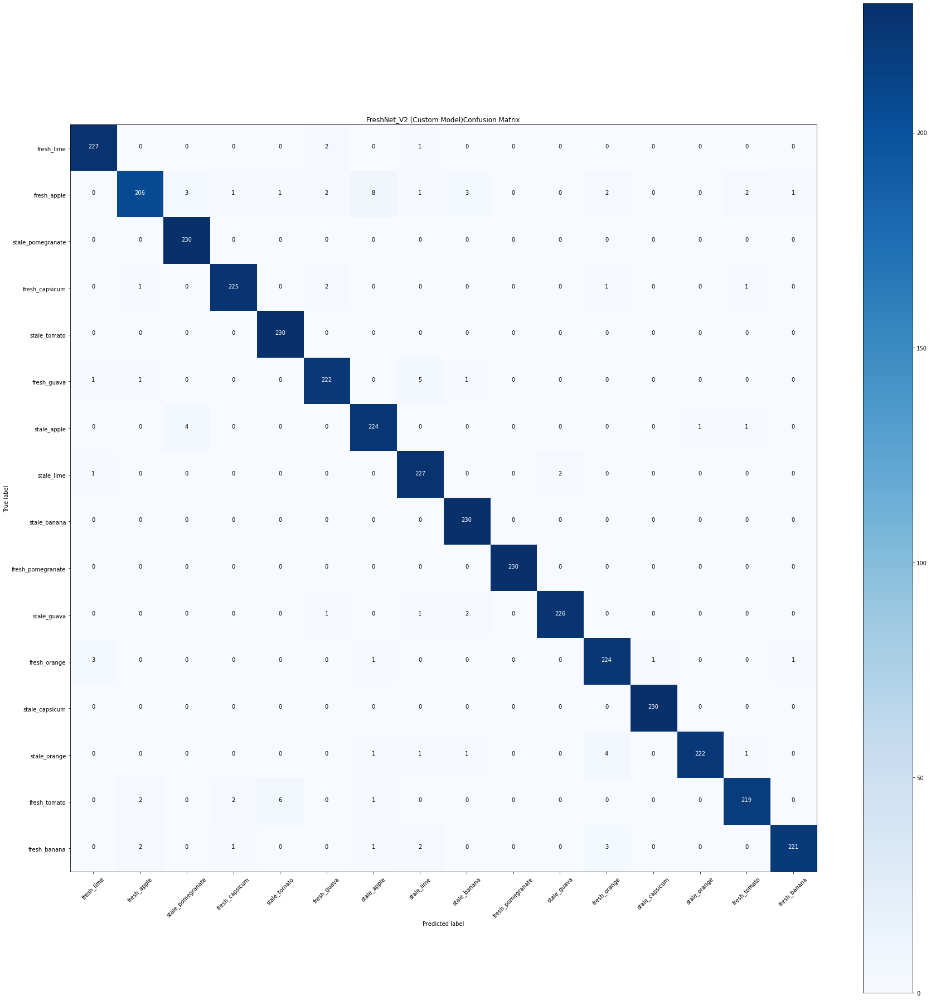

In [ ]:
ConfusionMatrix(loaded_freshDNN, name)

In [ ]:
ROC_AUC, Classification_Report = ROC_AUC_Classification_Report(loaded_freshDNN, name)

115/115 [==============================] - 37s 318ms/step


115/115 [==============================] - 32s 274ms/step


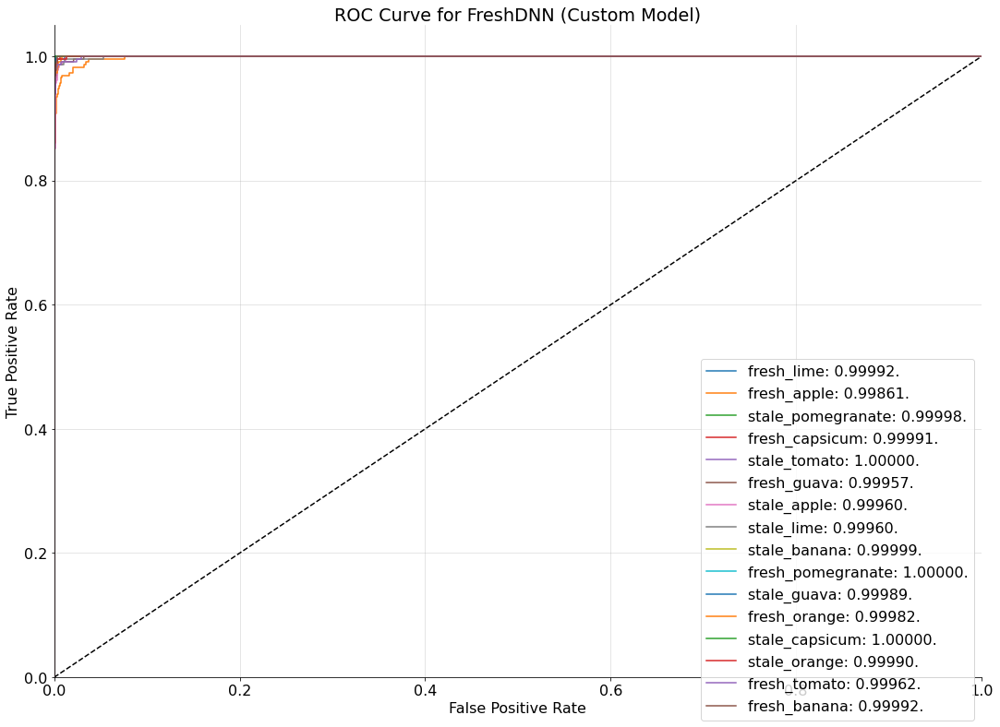

In [ ]:
plot_roc_curve(loaded_freshDNN, name)

In [ ]:
print(f"    ROC-AUC Score:      {ROC_AUC}\n")

    ROC-AUC Score:      0.9997698881537492



In [ ]:
print(Classification_Report)

                   precision    recall  f1-score   support

       fresh_lime       0.98      0.99      0.98       230
      fresh_apple       0.97      0.90      0.93       230
stale_pomegranate       0.97      1.00      0.99       230
   fresh_capsicum       0.98      0.98      0.98       230
     stale_tomato       0.97      1.00      0.99       230
      fresh_guava       0.97      0.97      0.97       230
      stale_apple       0.95      0.97      0.96       230
       stale_lime       0.95      0.99      0.97       230
     stale_banana       0.97      1.00      0.99       230
fresh_pomegranate       1.00      1.00      1.00       230
      stale_guava       0.99      0.98      0.99       230
     fresh_orange       0.96      0.97      0.97       230
   stale_capsicum       1.00      1.00      1.00       230
     stale_orange       1.00      0.97      0.98       230
     fresh_tomato       0.98      0.95      0.96       230
     fresh_banana       0.99      0.96      0.98       

In [ ]:
TestAccuracy = TestingAccuracy(loaded_freshDNN, name)
print(f"    Test Accuracy:      {TestAccuracy}\n")

115/115 [==============================] - 32s 275ms/step
    Test Accuracy:      0.9763586956521739



# **Calculate Accuracy From Output Text**

In [ ]:
import matplotlib.pyplot as plt
def bar(title, labels, x_label, y_label, bar_height, root_path, color):
    fig, ax = plt.subplots()
    # plt.figure(figsize=(10, 10))

    bar_x = list(range(1, len(labels)+1))
    bar_tick_label = labels
    bar_label = bar_height

    bar_plot = plt.bar(bar_x,bar_height,tick_label=bar_tick_label, color=color)

    def autolabel(rects):
      for idx,rect in enumerate(bar_plot):
          height = rect.get_height()
          ax.text(rect.get_x() + rect.get_width()/2., 0.1*height,
                  bar_label[idx],
                  ha='center', va='bottom', rotation=90, fontname='Arial', fontsize=14, weight="bold")

    autolabel(bar_plot)

    #   plt.ylim(0,100)

    plt.title(title)
    plt.xticks(rotation=90)
    plt.xlabel(x_label)
    plt.ylabel(y_label)
    plt.savefig(root_path+title+'.png')
    plt.grid(True)
    plt.show()

In [ ]:
labels = []
last_accuracy = []
last_val_accuracy = []
total_time = []
roc_acc_arr = []
test_acc_arr = []

In [ ]:
def accuracy_and_time_finder(text):
  import os
  import re




  text_file = open(text, "r")
  data = text_file.read() 
  text_file.close()


  acc = re.findall(" accuracy: [-+]?[0-9]*\.?[0-9]* ", data)
  accuracy = []
  for i in acc:
    acc = re.findall("\d+\.\d+", i)
    accuracy.append(acc[0])
  accuracy = [float(x) for x in accuracy]
  print(f"accuracy: {accuracy}")
  lastacc= accuracy[-1]*100
  last_accuracy.append(lastacc)
  print(f"Last Accuracy: {lastacc}%")


  print()

  val_acc = re.findall(" val_accuracy: [-+]?[0-9]*\.?[0-9]*", data)
  val_accuracy = []
  for i in val_acc:
    val_acc = re.findall("\d+\.\d+", i)
    val_accuracy.append(val_acc[0])
  val_accuracy = [float(x) for x in val_accuracy]
  print(f"val_accuracy: {val_accuracy}")
  lastvalacc= val_accuracy[-1]*100
  last_val_accuracy.append(lastvalacc)
  print(f"Last Validation Accuracy: { lastvalacc}%")


  print()


  time = re.findall("- [-+]?[0-9]*\.?[0-9]*s", data)
  time = [x.replace("- ", "") for x in time]
  time = [x.replace("s", "") for x in time]
  time = [int(i) for i in time]
  print(f"time: {time}")
  total_time.append(sum(time)/60)
  print(f"Total Training Time: {sum(time)} s = {sum(time)/60} min")

In [ ]:
# import OS module
def getFileNames(path):  
  import os

  dir_list = os.listdir(path)

  # print("Files and directories in '", path, "' :")
  # print(dir_list)
  # prints all files
  return dir_list

In [ ]:
import os
from pathlib import Path

from matplotlib import test
root_dir = root_location+"/Code/Thesis Save Data/"
dir_list = getFileNames(root_dir)
# print(dir_list)
target_text = []
for folder in dir_list:
  file_directory = root_dir+folder
  # print(file_directory)

  files = getFileNames(file_directory)
  
  for i in range( len(files)):
    files[i] = file_directory+ '/' +files[i]
  
  # print(files)

  for x in files:
    if x.endswith(".txt"):
      basename = Path(os.path.basename(x)).stem
      labels.append(basename)
      print(basename+":")
      print()
      # Prints only text file present in My Folder
      accuracy_and_time_finder(x)
      print("\n"*5)

XCEPTION:

accuracy: [0.6082, 0.7778, 0.836, 0.8661, 0.8814, 0.8955, 0.9114, 0.9214, 0.9253, 0.929, 0.9365, 0.946, 0.9477, 0.9541, 0.9538, 0.9558, 0.9615, 0.9652, 0.9616, 0.9641, 0.9658, 0.9703, 0.9757, 0.9686, 0.97, 0.9758, 0.9761, 0.9725, 0.9788, 0.9763]
Last Accuracy: 97.63%

val_accuracy: [0.7072, 0.7504, 0.8026, 0.8026, 0.7992, 0.8096, 0.8476, 0.8361, 0.8467, 0.8288, 0.8558, 0.8499, 0.861, 0.8431, 0.8425, 0.8624, 0.8641, 0.8383, 0.8552, 0.8458, 0.8727, 0.8421, 0.8693, 0.8606, 0.875, 0.8617, 0.8592, 0.8747, 0.8693, 0.8735]
Last Validation Accuracy: 87.35000000000001%

time: [135, 133, 131, 131, 133, 132, 134, 131, 133, 133, 131, 134, 134, 133, 133, 133, 133, 132, 131, 131, 131, 133, 131, 133, 131, 133, 135, 132, 133, 133]
Total Training Time: 3976 s = 66.26666666666667 min






EFFICIENTNETV2L:

accuracy: [0.8305, 0.9194, 0.9401, 0.9505, 0.9563, 0.9613, 0.9664, 0.9711, 0.9713, 0.9727, 0.9768, 0.9792, 0.9776, 0.9809, 0.9814, 0.9821, 0.9809, 0.9847, 0.9845, 0.9837, 0.9847, 0.9858, 0

In [ ]:
import os
from pathlib import Path

from matplotlib import test
root_dir = root_location+"/Code/Thesis Save Data/"
dir_list = getFileNames(root_dir)


# print(dir_list)
for folder in dir_list:
  file_directory = root_dir+folder
  # print(file_directory)

  files = getFileNames(file_directory)
  
  for i in range( len(files)):
    files[i] = file_directory+ '/' +files[i]
  
  # print(files)

  for x in files:
    if x.endswith("ROC AUC Score.csv"):
      basename = Path(os.path.basename(x)).stem
      print(basename+":")
      # import pandas module 
      import pandas as pd 
    
      # making dataframe 
      df = pd.read_csv(x) 
   
      # output the dataframe
      roc_auc_from_csv = df.loc[0].at["ROC-auc Score"]*100
      roc_acc_arr.append(roc_auc_from_csv)
      print(roc_auc_from_csv)
      print()


      # print()
      # Prints only text file present in My Folder
      # accuracy_and_time_finder(x)
      # print("\n"*3)
      # import shutil 

      
      # shutil.copy(x, dest)

XCEPTION ROC AUC Score:
94.646963610586

EFFICIENTNETV2L ROC AUC Score:
99.85250078764965

MOBILENETV2 ROC AUC Score:
98.14354914933836

DENSENET201 ROC AUC Score:
98.08330970384372

VGG19 ROC AUC Score:
99.42586247637053

RESNET152V2 ROC AUC Score:
88.58509766855703

Inception_V3 ROC AUC Score:
87.8428717706364

FreshDNN (Custom Model) ROC AUC Score:
99.97698881537492



In [ ]:
import os
from pathlib import Path

from matplotlib import test
root_dir = root_location+"/Code/Thesis Save Data/"
dir_list = getFileNames(root_dir)


# print(dir_list)
for folder in dir_list:
  file_directory = root_dir+folder
  # print(file_directory)

  files = getFileNames(file_directory)
  
  for i in range( len(files)):
    files[i] = file_directory+ '/' +files[i]
  
  # print(files)

  for x in files:
    if x.endswith(" TEST Score.csv"):
      basename = Path(os.path.basename(x)).stem
      print(basename+":")
      # import pandas module 
      import pandas as pd 
    
      # making dataframe 
      df = pd.read_csv(x) 
   
      # output the dataframe
      test_auc_from_csv = df.loc[0].at["TEST-auc Score"]*100
      test_acc_arr.append(test_auc_from_csv)
      print(test_auc_from_csv)
      print()


      # print()
      # Prints only text file present in My Folder
      # accuracy_and_time_finder(x)
      # print("\n"*3)
      # import shutil 

      
      # shutil.copy(x, dest)

XCEPTION TEST Score:
87.09239130434783

EFFICIENTNETV2L TEST Score:
97.30978260869564

MOBILENETV2 TEST Score:
93.09782608695653

DENSENET201 TEST Score:
95.46195652173913

VGG19 TEST Score:
98.6141304347826

RESNET152V2 TEST Score:
78.39673913043478

Inception_V3 TEST Score:
74.59239130434783

FreshDNN (Custom Model) TEST Score:
97.6358695652174



In [ ]:
print(len(labels))
print(len(last_accuracy))
print(len(last_val_accuracy))
print(len(total_time))
print(len(roc_acc_arr))
print(len(test_acc_arr))

8
8
8
8
8
8


In [ ]:
dir_comparison_data = root_location+"/Code/Thesis Comparison Data/"

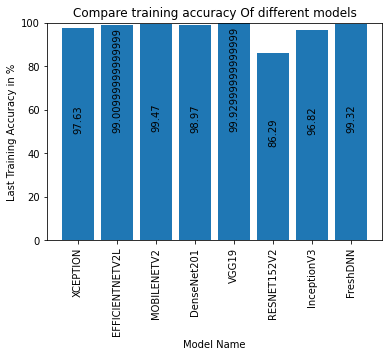

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots()
# plt.figure(figsize=(10, 10))

bar_x = [1,2,3,4,5,6,7,8]
bar_height = last_accuracy
bar_tick_label = labels
bar_label = last_accuracy

bar_plot = plt.bar(bar_x,bar_height,tick_label=bar_tick_label)

def autolabel(rects):
    for idx,rect in enumerate(bar_plot):
        height = rect.get_height()
        ax.text(rect.get_x() + rect.get_width()/2., 0.5*height,
                bar_label[idx],
                ha='center', va='bottom', rotation=90)

autolabel(bar_plot)

plt.ylim(0,100)

plt.title('Compare training accuracy Of different models')

plt.xticks(rotation=90)
plt.xlabel("Model Name")
plt.ylabel("Last Training Accuracy in %")
plt.savefig(dir_comparison_data+'Training Accuracy Comparison.png')
plt.show()

In [ ]:
import random
min = .7
max = .9
color=[]
for i in range(len(labels)):
    col = color.append(tuple([random.uniform(min,max), random.uniform(min,max), random.uniform(min,max)]))

print(color)

[(0.7815898767278564, 0.814576060646358, 0.8195027081702917), (0.8588207156748737, 0.8950547154568926, 0.8034057391637248), (0.7375778845319838, 0.89698628092099, 0.7271631324321572), (0.7346071177188518, 0.8254064398090366, 0.8741163340508629), (0.7366357314177967, 0.8587340205360628, 0.7397772118903558), (0.7326258627288544, 0.779475941221635, 0.7187240321630587), (0.8468113113506105, 0.738394420613047, 0.7748513777612642), (0.8517341435881777, 0.8968902501581932, 0.7966166473885463)]


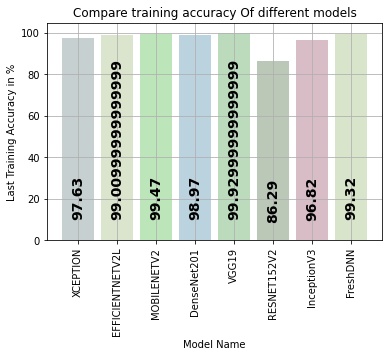

In [ ]:
bar('Compare training accuracy Of different models', labels, "Model Name", "Last Training Accuracy in %", bar_height, dir_comparison_data, color)

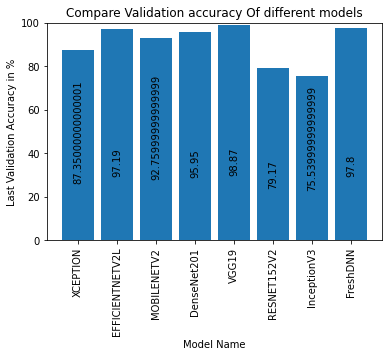

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots()
# plt.figure(figsize=(10, 10))

bar_x = [1,2,3,4,5,6,7,8]
bar_height = last_val_accuracy
bar_tick_label = labels
bar_label = last_val_accuracy

bar_plot = plt.bar(bar_x,bar_height,tick_label=bar_tick_label)

def autolabel(rects):
    for idx,rect in enumerate(bar_plot):
        height = rect.get_height()
        ax.text(rect.get_x() + rect.get_width()/2., 0.3*height,
                bar_label[idx],
                ha='center', va='bottom', rotation=90)

autolabel(bar_plot)

plt.ylim(0,100)

plt.title('Compare Validation accuracy Of different models')

plt.xticks(rotation=90)
plt.xlabel("Model Name")
plt.ylabel("Last Validation Accuracy in %")
plt.savefig(dir_comparison_data+'Validation Accuracy Comparison.png')
plt.show()

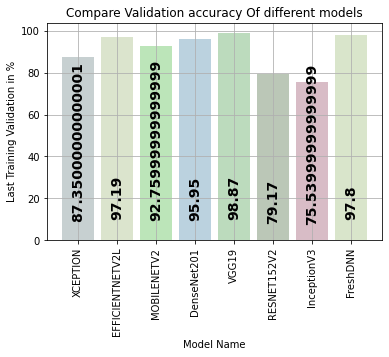

In [ ]:
bar('Compare Validation accuracy Of different models', labels, "Model Name", "Last Training Validation in %", bar_height, dir_comparison_data, color)

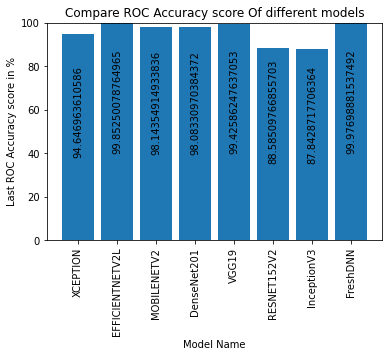

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots()
# plt.figure(figsize=(10, 10))


bar_x = [1,2,3,4,5,6,7,8]
bar_height = roc_acc_arr
bar_tick_label = labels
bar_label = roc_acc_arr

bar_plot = plt.bar(bar_x,bar_height,tick_label=bar_tick_label)

def autolabel(rects):
    for idx,rect in enumerate(bar_plot):
        height = rect.get_height()
        ax.text(rect.get_x() + rect.get_width()/2., 0.4*height,
                bar_label[idx],
                ha='center', va='bottom', rotation=90)

autolabel(bar_plot)

plt.ylim(0,100)

plt.title("Compare ROC Accuracy score Of different models")

plt.xticks(rotation=90)
plt.xlabel("Model Name")
plt.ylabel("Last ROC Accuracy score in %")
plt.savefig(dir_comparison_data+'ROC Accuracy score Comparison.png')
plt.show()

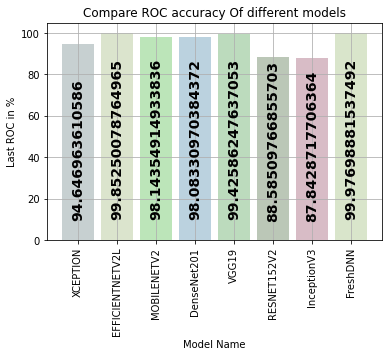

In [ ]:
bar('Compare ROC accuracy Of different models', labels, "Model Name", "Last ROC in %", bar_height, dir_comparison_data, color)

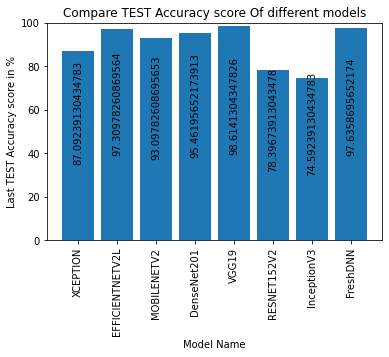

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots()
# plt.figure(figsize=(10, 10))


bar_x = [1,2,3,4,5,6,7,8]
bar_height = test_acc_arr
bar_tick_label = labels
bar_label = test_acc_arr

bar_plot = plt.bar(bar_x,bar_height,tick_label=bar_tick_label)

def autolabel(rects):
    for idx,rect in enumerate(bar_plot):
        height = rect.get_height()
        ax.text(rect.get_x() + rect.get_width()/2., 0.4*height,
                bar_label[idx],
                ha='center', va='bottom', rotation=90)

autolabel(bar_plot)

plt.ylim(0,100)

plt.title("Compare TEST Accuracy score Of different models")

plt.xticks(rotation=90)
plt.xlabel("Model Name")
plt.ylabel("Last TEST Accuracy score in %")
plt.savefig(dir_comparison_data+'TEST Accuracy score Comparison.png')
plt.show()

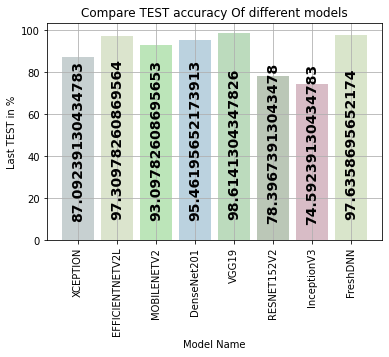

In [ ]:
bar('Compare TEST accuracy Of different models', labels, "Model Name", "Last TEST in %", bar_height, dir_comparison_data, color)

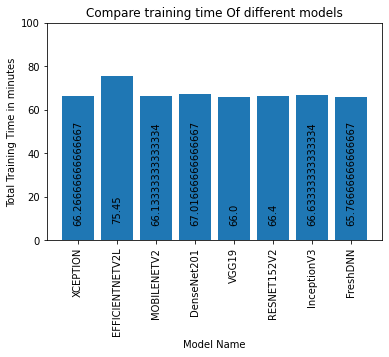

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots()
# plt.figure(figsize=(10, 10))

bar_x = [1,2,3,4,5,6,7,8]
bar_height = total_time
bar_tick_label = labels
bar_label = total_time

bar_plot = plt.bar(bar_x,bar_height,tick_label=bar_tick_label)

def autolabel(rects):
    for idx,rect in enumerate(bar_plot):
        height = rect.get_height()
        ax.text(rect.get_x() + rect.get_width()/2., 0.1*height,
                bar_label[idx],
                ha='center', va='bottom', rotation=90)

autolabel(bar_plot)

plt.ylim(0,100)

plt.title("Compare training time Of different models")

plt.xticks(rotation=90)
plt.xlabel("Model Name")
plt.ylabel("Total Training Time in minutes")
plt.savefig(dir_comparison_data+'Training Time Comparison.png')
plt.show()

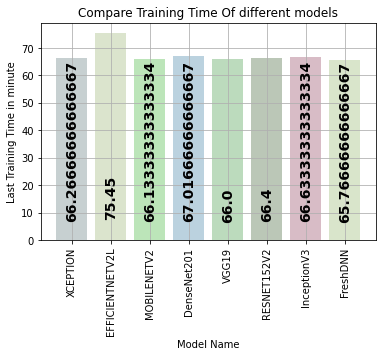

In [ ]:
bar('Compare Training Time Of different models', labels, "Model Name", "Last Training Time in minute", bar_height, dir_comparison_data, color)

In [ ]:
import pandas as pd

data = {'Model Name':labels, 'Last Training Accuracy(%)': last_accuracy, 'Last Validation Accuracy(%)': last_val_accuracy, 'roc_auc_score(%)':roc_acc_arr, 'Testing Accuracy(%)':test_acc_arr, 'Total Training Time(min)': total_time}

comparison = pd.DataFrame(data)

comparison.to_csv(dir_comparison_data+"data.csv",index=False)

comparison

,Model Name,Last Training Accuracy(%),Last Validation Accuracy(%),roc_auc_score(%),Testing Accuracy(%),Total Training Time(min)
0,XCEPTION,97.63,87.35,94.646964,87.092391,66.266667
1,EFFICIENTNETV2L,99.01,97.19,99.852501,97.309783,75.450000
2,MOBILENETV2,99.47,92.76,98.143549,93.097826,66.133333
3,DenseNet201,98.97,95.95,98.083310,95.461957,67.016667
4,VGG19,99.93,98.87,99.425862,98.614130,66.000000
5,RESNET152V2,86.29,79.17,88.585098,78.396739,66.400000
6,InceptionV3,96.82,75.54,87.842872,74.592391,66.633333
7,FreshDNN,99.32,97.80,99.976989,97.635870,65.766667


In [ ]:
!pip install dataframe_image

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 6.5 MB 7.8 MB/s 


In [ ]:
!apt-get update
!apt install chromium-chromedriver
!cp /usr/lib/chromium-browser/chromedriver /usr/bin
!pip install selenium

Get:1 https://cloud.r-project.org/bin/linux/ubuntu bionic-cran40/ InRelease [3,626 B]
Ign:2 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  InRelease
Hit:3 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  InRelease
Hit:4 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  Release
Get:5 http://security.ubuntu.com/ubuntu bionic-security InRelease [88.7 kB]
Get:6 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/ubuntu bionic InRelease [15.9 kB]
Get:7 https://cloud.r-project.org/bin/linux/ubuntu bionic-cran40/ Packages [92.1 kB]
Hit:8 http://archive.ubuntu.com/ubuntu bionic InRelease
Get:9 http://archive.ubuntu.com/ubuntu bionic-updates InRelease [88.7 kB]
Hit:11 http://ppa.launchpad.net/cran/libgit2/ubuntu bionic InRelease
Hit:12 http://ppa.launchpad.net/deadsnakes/ppa/ubuntu bionic InRelease
Get:13 http://archive.ubuntu.com/ubuntu bionic-backports InRelease [74.6 kB]
Hit:14 http://ppa.laun

In [ ]:
import pandas as pd
import numpy as np
import dataframe_image as dfi

df_styled = comparison.style.background_gradient() #adding a gradient based on values in cell

dfi.export(df_styled, dir_comparison_data+"Comparson Between Different Models Before Applying K-Fold.png")

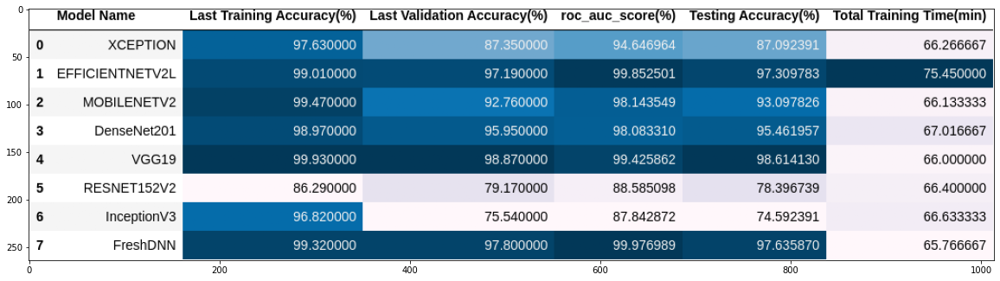

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from matplotlib.pyplot import figure
figure(figsize=(20, 10))
image_path = dir_comparison_data+"Comparson Between Different Models Before Applying K-Fold.png"
image = mpimg.imread(image_path)
plt.imshow(image)
plt.show()